<a href="https://colab.research.google.com/github/arthurw125/GAN_Research/blob/main/Conditioned_CycleGAN_MultCycle_3to1_v2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Uses 3 Camera Views to Reproduce the Missing 4th Camera View (Multiple Generators and Discriminators)

## Setup

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
!pip install tensorflow_addons
import tensorflow_addons as tfa
import tensorflow_datasets as tfds

tfds.disable_progress_bar()
autotune = tf.data.AUTOTUNE

import json
import cv2

In [ ]:
class DataReader:

    def __init__(self, image_dir, label_dir, num_cam, start_frame=0, end_frame=0, save_videos=False):
        self._image_dir = image_dir
        self._label_dir = label_dir
        self._num_cam = num_cam
        self._start_frame = start_frame
        self._end_frame = end_frame
        self._save_videos = save_videos

        if self._save_videos:
            self._rgb_videos = {}
            for cam_id in range(1, self._num_cam+1):
                self._rgb_videos[cam_id] = cv2.VideoWriter('video_camera_view_'+str(cam_id)+'.avi', cv2.VideoWriter_fourcc(*'MJPG'), 15, (640, 360))
                #self._rgb_videos[cam_id] = cv2.VideoWriter('video_camera_view_'+str(cam_id)+'.mp4', cv2.VideoWriter_fourcc(*'mp4v'), 15, (640, 360))
                #self._rgb_videos[cam_id] = cv2.VideoWriter('video_camera_view_'+str(cam_id)+'.mov', cv2.VideoWriter_fourcc(*'H264'), 15, (640, 360))
    def __del__(self):
        if self._save_videos:
            for _, out_video in self._rgb_videos.items():
                out_video.release()

    def read(self, frame_id):
        rgbs = {}
        labels = {}
        for cam_id in range(1, self._num_cam+1):
            rgb = cv2.imread(os.path.join(self._image_dir, 'rgb_'+str(frame_id).zfill(5)+'_'+str(cam_id)+'.jpg'), cv2.IMREAD_UNCHANGED)
            label = json.load(open(os.path.join(self._label_dir, 'rgb_'+str(frame_id).zfill(5)+'_'+str(cam_id)+'.json')))
            rgbs[cam_id] = rgb
            labels[cam_id] = label

        return rgbs, labels
    
    def plot(self):
        for frame_id in range(self._start_frame, self._end_frame):
            rgbs, labels = self.read(frame_id)
            for cam_id in range(1, self._num_cam+1):
                rgb = rgbs[cam_id]
                tracklet = labels[cam_id]
                '''
                //code for adding bounding box around the people
                for id, (x_min, y_min, x_max, y_max) in tracklet.items():
                    rgb = cv2.rectangle(rgb, (int(x_min), int(y_min)), (int(x_max), int(y_max)), (0, 0, 255), 2)
                    rgb = cv2.putText(rgb, str(id), (int(x_min), int(y_min)), cv2.FONT_HERSHEY_PLAIN, 2, (0, 255, 0), 2, cv2.LINE_AA)
                rgb = cv2.putText(rgb, str(frame_id), (30, 30), cv2.FONT_HERSHEY_PLAIN, 1, (255, 255, 0), 2, cv2.LINE_AA)
                '''
                if self._save_videos:
                    self._rgb_videos[cam_id].write(rgb)

In [ ]:
def img_seq_resize(data, start, end):
  rows = []
  for i in range(start,end):
    img = tf.image.resize(data[:,i,...], [100, 100],preserve_aspect_ratio=True,method=tf.image.ResizeMethod.BILINEAR)
    rows.append(img)
  img_seq = tf.stack(rows, axis=1)
  return img_seq

In [ ]:
def create_dataset(image_dir, label_dir, num_cam, start_frame, end_frame):
    my_data = []
    my_labels = []
    count = 0
    data_reader = DataReader(image_dir, label_dir, num_cam, start_frame, end_frame, False)
    for frame_id in range(start_frame, end_frame):
        data, labels = data_reader.read(frame_id)
        my_list = list(data.values())
        my_list = np.array(my_list)
        my_data.append(my_list)
        my_labels.append(labels)
        if count % 100 == 0:
          print('frame_id:',frame_id)
        count += 1
    my_data = np.array(my_data)
    my_labels = np.array(my_labels)
    cyc_data = {'A': tf.data.Dataset.from_tensor_slices(img_seq_resize(my_data, 0, 3)),
                'B': tf.data.Dataset.from_tensor_slices(img_seq_resize(my_data, 3, 4))}
  
    return cyc_data, my_labels 

## Prepare the dataset



In [ ]:

image_dir = '/content/drive/MyDrive/Research/train/images/63am/cafe_shop_0'
label_dir = '/content/drive/MyDrive/Research/train/labels/63am/cafe_shop_0'
num_cam = 4

start_frame, end_frame = 0, 100
dataset_train, _ = create_dataset(image_dir, label_dir, num_cam, start_frame, end_frame)
#dataset_train = tf.data.Dataset.from_tensor_slices(dataset_train)
start_frame, end_frame = 100, 150
dataset_test, _ = create_dataset(image_dir, label_dir, num_cam, start_frame, end_frame)
#dataset_test = tf.data.Dataset.from_tensor_slices(dataset_test)


frame_id: 0
frame_id: 100


In [ ]:
print(dataset_train)
print(dataset_test)
train_angles_3, train_angles_1 = dataset_train['A'], dataset_train['B']
test_angles_3, test_angles_1 = dataset_test['A'], dataset_test['B']
# Define the standard image size.
orig_img_size = (360, 640)
# Size of the random crops to be used during training.
input_img_size = (45, 80, 3)
# Weights initializer for the layers.
kernel_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
# Gamma initializer for instance normalization.
gamma_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)

#buffer_size = 256
buffer_size = 256
batch_size = 8


def normalize_img(img):
    img = tf.cast(img, dtype=tf.float32)
    # Map values in the range [-1, 1]
    return (img / 127.5) - 1.0


def preprocess_train_image(img):
    # Random flip
    #img = tf.image.random_flip_left_right(img)
    # Resize to the original size first
    #img = tf.image.resize(img, [*orig_img_size])
    # Random crop to 256X256
    #img = tf.image.random_crop(img, size=[*input_img_size])
    # Normalize the pixel values in the range [-1, 1]
    img = normalize_img(img)
    return img


def preprocess_test_image(img):
    # Only resizing and normalization for the test images.
    #img = tf.image.resize(img, [input_img_size[0], input_img_size[1]])
    img = normalize_img(img)
    return img


{'A': <TensorSliceDataset shapes: (3, 56, 100, 3), types: tf.float32>, 'B': <TensorSliceDataset shapes: (1, 56, 100, 3), types: tf.float32>}
{'A': <TensorSliceDataset shapes: (3, 56, 100, 3), types: tf.float32>, 'B': <TensorSliceDataset shapes: (1, 56, 100, 3), types: tf.float32>}


In [ ]:
dataset_train['A']
# original img size (360, 640, 3)

<TensorSliceDataset shapes: (3, 56, 100, 3), types: tf.float32>

In [ ]:
dataset_train['B']

<TensorSliceDataset shapes: (1, 56, 100, 3), types: tf.float32>

## Create `Dataset` objects

In [ ]:
#train_angles_3.shape, train_angles_1.shape

In [ ]:
batch_size = 16

In [ ]:

train_angles_3 = (
    train_angles_3.map(preprocess_train_image, num_parallel_calls=autotune)
    .cache()
    .shuffle(buffer_size)
    .batch(batch_size)
)
train_angles_1 = (
    train_angles_1.map(preprocess_train_image, num_parallel_calls=autotune)
    .cache()
    .shuffle(buffer_size)
    .batch(batch_size)
)

# Apply the preprocessing operations to the test data
test_angles_3 = (
    test_angles_3.map(preprocess_test_image, num_parallel_calls=autotune)
    .cache()
    #.shuffle(buffer_size)
    .batch(1)
)
test_angles_1 = (
    test_angles_1.map(preprocess_test_image, num_parallel_calls=autotune)
    .cache()
    #.shuffle(buffer_size)
    .batch(1)
)


## Visualize some samples

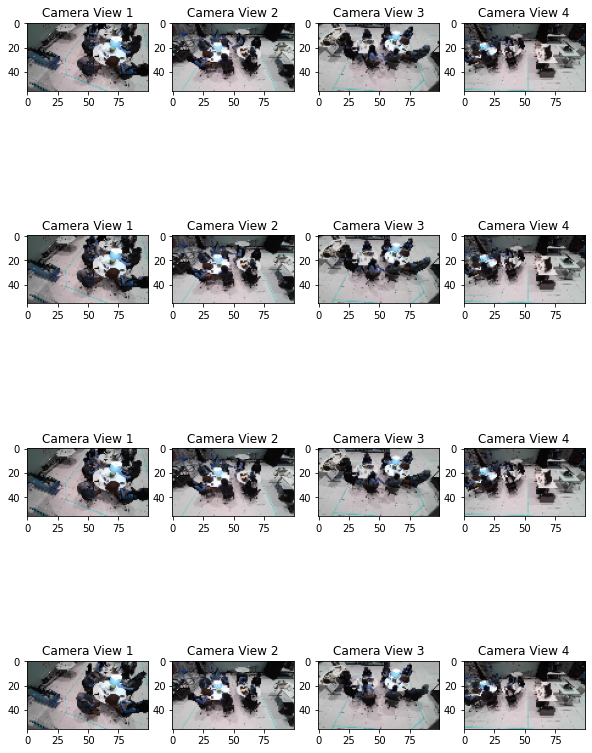

In [ ]:

_, ax = plt.subplots(4, 4, figsize=(10, 15))
for i, samples in enumerate(zip(train_angles_3.take(4), train_angles_1.take(4))):
    cam1 = (((samples[0][0][0] * 127.5) + 127.5).numpy()).astype(np.uint8)
    cam2 = (((samples[0][0][1] * 127.5) + 127.5).numpy()).astype(np.uint8)
    cam3 = (((samples[0][0][2] * 127.5) + 127.5).numpy()).astype(np.uint8)
    cam4 = (((samples[1][0][0] * 127.5) + 127.5).numpy()).astype(np.uint8)
    #ax[i, 0].imshow(samples[0][0])
    #ax[i, 1].imshow(samples[1][0])
    ax[i, 0].imshow(cam1)
    ax[i, 1].imshow(cam2)
    ax[i, 2].imshow(cam3)
    ax[i, 3].imshow(cam4)
    ax[i, 0].set_title("Camera View 1")
    ax[i, 1].set_title("Camera View 2")
    ax[i, 2].set_title("Camera View 3")
    ax[i, 3].set_title("Camera View 4")
plt.show()


## Building blocks used in the CycleGAN generators and discriminators

In [ ]:

class ReflectionPadding2D(layers.Layer):
    """Implements Reflection Padding as a layer.

    Args:
        padding(tuple): Amount of padding for the
        spatial dimensions.

    Returns:
        A padded tensor with the same type as the input tensor.
    """

    def __init__(self, padding=(1, 1, 1), **kwargs):
        self.padding = tuple(padding)
        super(ReflectionPadding2D, self).__init__(**kwargs)

    def call(self, input_tensor, mask=None):
        '''
        padding_width, padding_height = self.padding
        padding_tensor = [
            [0, 0],
            [padding_height, padding_height],
            [padding_width, padding_width],
            [0, 0],
        ]
        '''
        #return tf.pad(input_tensor, padding_tensor, mode="REFLECT")
        return tf.keras.layers.ZeroPadding3D(padding=self.padding)(input_tensor)


def residual_block(
    x,
    activation,
    kernel_initializer=kernel_init,
    kernel_size=(3, 3, 3),
    strides=(1, 1, 1),
    padding="valid",
    gamma_initializer=gamma_init,
    use_bias=False,
):
    dim = x.shape[-1]
    input_tensor = x

    x = ReflectionPadding2D()(input_tensor)
    x = layers.Conv3D(
        dim,
        kernel_size,
        strides=strides,
        kernel_initializer=kernel_initializer,
        padding=padding,
        use_bias=use_bias,
    )(x)
    x = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(x)
    x = activation(x)

    x = ReflectionPadding2D()(x)
    x = layers.Conv3D(
        dim,
        kernel_size,
        strides=strides,
        kernel_initializer=kernel_initializer,
        padding=padding,
        use_bias=use_bias,
    )(x)
    x = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(x)
    x = layers.add([input_tensor, x])
    return x


def downsample(
    x,
    filters,
    activation,
    kernel_initializer=kernel_init,
    kernel_size=(3, 3, 3),
    strides=(2, 2, 2),
    padding="same",
    gamma_initializer=gamma_init,
    use_bias=False,
):
    x = layers.Conv3D(
        filters,
        kernel_size,
        strides=strides,
        kernel_initializer=kernel_initializer,
        padding=padding,
        use_bias=use_bias,
    )(x)
    x = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(x)
    if activation:
        x = activation(x)
    return x


def upsample(
    x,
    filters,
    activation,
    kernel_size=(3, 3, 3),
    strides=(2, 2, 2),
    padding="same",
    kernel_initializer=kernel_init,
    gamma_initializer=gamma_init,
    use_bias=False,
):
    x = layers.Conv3DTranspose(
        filters,
        kernel_size,
        strides=strides,
        padding=padding,
        kernel_initializer=kernel_initializer,
        use_bias=use_bias,
    )(x)
    x = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(x)
    if activation:
        x = activation(x)
    return x


## Build the generators


In [ ]:

def get_resnet_generator(
    filters=64,
    num_downsampling_blocks=2,
    num_residual_blocks=2, # orig 9
    num_upsample_blocks=2,
    gamma_initializer=gamma_init,
    name=None,
    input_img_size=None,
    tag=None
):
    img_input = layers.Input(shape=input_img_size, name=name + "_img_input")
    x = ReflectionPadding2D(padding=(3, 3, 3))(img_input)
    x = layers.Conv3D(filters, (7, 7, 7), kernel_initializer=kernel_init, use_bias=False)(
        x
    )
    x = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(x)
    x = layers.Activation("relu")(x)

    # Downsampling
    for _ in range(num_downsampling_blocks):
        filters *= 2
        x = downsample(x, filters=filters, activation=layers.Activation("relu"))

    # Residual blocks
    
    for _ in range(num_residual_blocks):
        x = residual_block(x, activation=layers.Activation("relu"))
    
    # Upsampling
    for _ in range(num_upsample_blocks):
        filters //= 2
        x = upsample(x, filters, activation=layers.Activation("relu"))
    if tag=='g' or tag=='G':
      #out = 1*112*200*3 # compute dense layer output for G
      out = 1*56*100*3
      #shape = [1,112,200,3]
      shape = [1,56,100,3]
    elif tag=='f' or tag=='F':
      #out = 3*112*200*3 # compute dense layer output for F 
      out = 3*56*100*3
      #shape = [3,112,200,3]
      shape = [3,56,100,3]
    # Final block
    x = ReflectionPadding2D(padding=(3, 3, 3))(x)
    x = layers.Conv3D(3, (7, 7, 7), padding="valid")(x)
    #x = layers.Flatten()(x)
    x = layers.GlobalAveragePooling3D()(x)
    x = layers.Dense(out)(x)
    x = layers.Activation("tanh")(x)
    x = layers.Reshape(shape)(x)

    model = keras.models.Model(img_input, x, name=name)
    return model


## Build the discriminators


In [ ]:

def get_discriminator(
    filters=64, 
    kernel_initializer=kernel_init, 
    num_downsampling=3, 
    name=None,
    input_img_size=None,
    cond_input_size=None
):
    img_input = layers.Input(shape=input_img_size, name=name + "_img_input")
    cond_input = layers.Input(shape=cond_input_size, name="conditioned_input")
    #cond = layers.Flatten()(cond_input)
    cond = layers.GlobalAveragePooling3D()(cond_input)
    cond = layers.Dense(input_img_size[0]*input_img_size[1]*input_img_size[2]*input_img_size[3])(cond)
    cond = layers.Reshape(input_img_size)(cond)
    merge = layers.Concatenate()([img_input,cond])
    x = layers.Conv3D(
        filters,
        (4, 4, 4),
        strides=(2, 2, 2),
        padding="same",
        kernel_initializer=kernel_initializer,
    )(merge)
    x = layers.LeakyReLU(0.2)(x)

    num_filters = filters
    for num_downsample_block in range(3):
        num_filters *= 2
        if num_downsample_block < 2:
            x = downsample(
                x,
                filters=num_filters,
                activation=layers.LeakyReLU(0.2),
                kernel_size=(4, 4, 4),
                strides=(2, 2, 2),
            )
        else:
            x = downsample(
                x,
                filters=num_filters,
                activation=layers.LeakyReLU(0.2),
                kernel_size=(4, 4, 4),
                strides=(1, 1, 1),
            )

    x = layers.Conv3D(
        1, (4, 4, 4), strides=(1, 1, 1), padding="same", kernel_initializer=kernel_initializer
    )(x)

    x = layers.Flatten()(x)
    x = layers.Dense(1, activation='sigmoid')(x)
    #model = keras.models.Model(inputs=img_input, outputs=x, name=name)
    model = keras.models.Model(inputs=[img_input,cond_input], outputs=x, name=name)
    return model

In [ ]:
# Get the generators
'''
gen_G = get_resnet_generator(name="generator_G", input_img_size=(3, 112, 200, 3), tag='G')
gen_F = get_resnet_generator(name="generator_F", input_img_size=(1,112, 200, 3), tag='F')
'''
gen_X = get_resnet_generator(name="generator_X", input_img_size=(3, 56, 100, 3), tag='G')
gen_Y = get_resnet_generator(name="generator_Y", input_img_size=(3, 56, 100, 3), tag='G')
gen_Z = get_resnet_generator(name="generator_Z", input_img_size=(3, 56, 100, 3), tag='G')
gen_W = get_resnet_generator(name="generator_W", input_img_size=(3, 56, 100, 3), tag='G')
# Get the discriminators
'''
disc_X = get_discriminator(name="discriminator_X", input_img_size=(3, 112, 200, 3))
disc_Y = get_discriminator(name="discriminator_Y", input_img_size=(1, 112, 200, 3))
'''
disc_X = get_discriminator(name="discriminator_X", input_img_size=(1, 56, 100, 3), cond_input_size=(3, 56, 100, 3))
disc_Y = get_discriminator(name="discriminator_Y", input_img_size=(1, 56, 100, 3), cond_input_size=(3, 56, 100, 3))
disc_Z = get_discriminator(name="discriminator_Z", input_img_size=(1, 56, 100, 3), cond_input_size=(3, 56, 100, 3))
disc_W = get_discriminator(name="discriminator_W", input_img_size=(1, 56, 100, 3), cond_input_size=(3, 56, 100, 3))

In [ ]:
from keras.utils.vis_utils import plot_model

In [ ]:
gen_X.summary()

Model: "generator_X"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 generator_X_img_input (InputLa  [(None, 3, 56, 100,  0          []                               
 yer)                            3)]                                                              
                                                                                                  
 reflection_padding2d (Reflecti  (None, 9, 62, 106,   0          ['generator_X_img_input[0][0]']  
 onPadding2D)                   3)                                                                
                                                                                                  
 conv3d (Conv3D)                (None, 3, 56, 100,   65856       ['reflection_padding2d[0][0]']   
                                64)                                                     

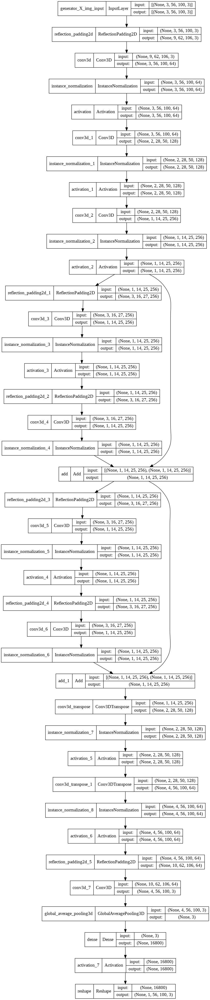

In [ ]:
plot_model(gen_X, to_file='discriminator_plot.png', show_shapes=True, show_layer_names=True)

In [ ]:
disc_X.summary()

Model: "discriminator_X"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 conditioned_input (InputLayer)  [(None, 3, 56, 100,  0          []                               
                                 3)]                                                              
                                                                                                  
 global_average_pooling3d_4 (Gl  (None, 3)           0           ['conditioned_input[0][0]']      
 obalAveragePooling3D)                                                                            
                                                                                                  
 dense_4 (Dense)                (None, 16800)        67200       ['global_average_pooling3d_4[0][0
                                                                 ]']                

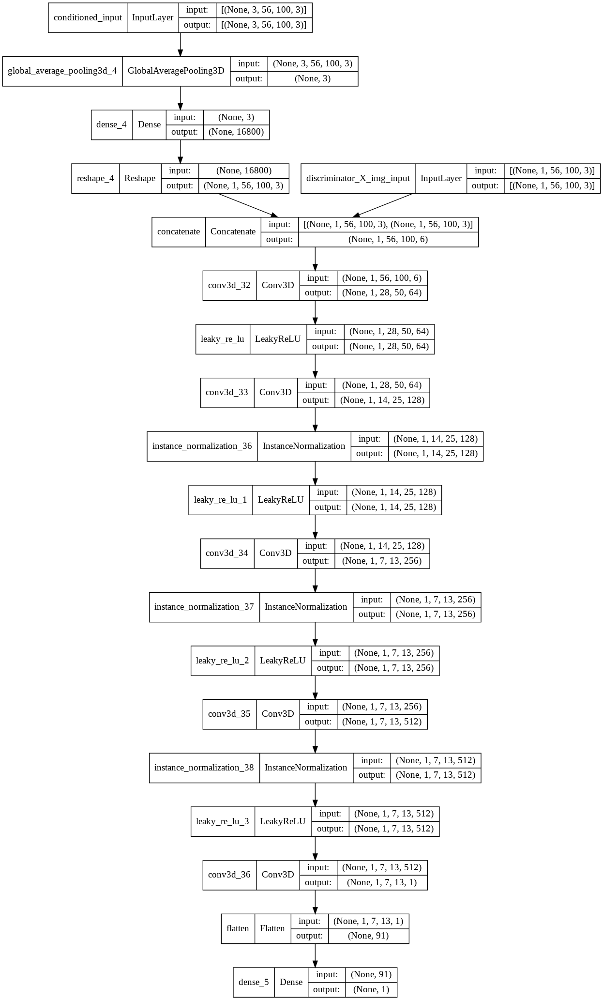

In [ ]:
plot_model(disc_X, to_file='discriminator_plot.png', show_shapes=True, show_layer_names=True)

## Build the CycleGAN model

We will override the `train_step()` method of the `Model` class
for training via `fit()`.

In [ ]:

class CycleGan(keras.Model):
    def __init__(
        self,
        generator_X,
        generator_Y,
        generator_Z,
        generator_W,
        discriminator_X,
        discriminator_Y,
        discriminator_Z,
        discriminator_W,
        lambda_cycle=10.0,
        lambda_identity=0.5,
    ):
        super(CycleGan, self).__init__()
        self.gen_X = generator_X
        self.gen_Y = generator_Y
        self.gen_Z = generator_Z
        self.gen_W = generator_W
        self.disc_X = discriminator_X
        self.disc_Y = discriminator_Y
        self.disc_Z = discriminator_Z
        self.disc_W = discriminator_W
        self.lambda_cycle = lambda_cycle
        self.lambda_identity = lambda_identity

    def compile(
        self,
        gen_X_optimizer,
        gen_Y_optimizer,
        gen_Z_optimizer,
        gen_W_optimizer,
        disc_X_optimizer,
        disc_Y_optimizer,
        disc_Z_optimizer,
        disc_W_optimizer,
        gen_loss_fn,
        disc_loss_fn,
    ):
        super(CycleGan, self).compile()
        self.gen_X_optimizer = gen_X_optimizer
        self.gen_Y_optimizer = gen_Y_optimizer
        self.gen_Z_optimizer = gen_Z_optimizer
        self.gen_W_optimizer = gen_W_optimizer
        self.disc_X_optimizer = disc_X_optimizer
        self.disc_Y_optimizer = disc_Y_optimizer
        self.disc_Z_optimizer = disc_Z_optimizer
        self.disc_W_optimizer = disc_W_optimizer
        self.generator_loss_fn = gen_loss_fn
        self.discriminator_loss_fn = disc_loss_fn
        self.cycle_loss_fn = keras.losses.MeanAbsoluteError()
        self.identity_loss_fn = keras.losses.MeanAbsoluteError()

    def train_step(self, batch_data):
        
        real_x, real_z = batch_data
        real_z = real_z[:,0,...]
        real_w,real_x,real_y = real_x[:,0,:,:,:],real_x[:,1,:,:,:],real_x[:,2,:,:,:]
        # For CycleGAN, we need to calculate different
        # kinds of losses for the generators and discriminators.
        # We will perform the following steps here:
        #
        # 1. Pass real images through the generators and get the generated images
        # 2. Pass the generated images back to the generators to check if we
        #    we can predict the original image from the generated image.
        # 3. Do an identity mapping of the real images using the generators.
        # 4. Pass the generated images in 1) to the corresponding discriminators.
        # 5. Calculate the generators total loss (adverserial + cycle + identity)
        # 6. Calculate the discriminators loss
        # 7. Update the weights of the generators
        # 8. Update the weights of the discriminators
        # 9. Return the losses in a dictionary

        with tf.GradientTape(persistent=True) as tape:
            '''
            # Horse to fake zebra
            fake_y = self.gen_G(real_x, training=True)
            # Zebra to fake horse -> y2x
            fake_x = self.gen_F(real_y, training=True)
            '''
            # w,x,y -> z'
            input1 = tf.stack([real_w,real_x,real_y],axis=1)
            #print("input1",input1.shape)
            fake_z = self.gen_Z(input1, training=True)
            # x,y,z -> w'
            input2 = tf.stack([real_x,real_y,real_z],axis=1)
            #print("input2",input2.shape)
            fake_w = self.gen_W(input2, training=True)
            # y,z,w -> x'
            input3 = tf.stack([real_y,real_z,real_w],axis=1)
            #print("input3",input3.shape)
            fake_x = self.gen_X(input3, training=True)
            # z,w,x -> y'
            input4 = tf.stack([real_z,real_w,real_x],axis=1)
            #print("input4",input4.shape)
            fake_y = self.gen_Y(input4, training=True)
            '''
            # Cycle (Horse to fake zebra to fake horse): x -> y -> x
            cycled_x = self.gen_F(fake_y, training=True)
            # Cycle (Zebra to fake horse to fake zebra) y -> x -> y
            cycled_y = self.gen_G(fake_x, training=True)
            '''
            # w',x',y' -> z''
            input11 = tf.squeeze(tf.stack([fake_w,fake_x,fake_y],axis=1), axis=2)
            #print("input11",input11.shape)
            fake_zz = self.gen_Z(input11, training=True)
            # x',y',z' -> w''
            input22 = tf.squeeze(tf.stack([fake_x,fake_y,fake_z],axis=1), axis=2)
            #print("input22",input22.shape)
            fake_ww = self.gen_W(input22, training=True)
            # y',z',w' -> x''
            input33 = tf.squeeze(tf.stack([fake_y,fake_z,fake_w],axis=1), axis=2)
            #print("input33",input33.shape)
            fake_xx = self.gen_X(input33, training=True)
            # z',w',x' -> y''
            input44 = tf.squeeze(tf.stack([fake_z,fake_w,fake_x],axis=1), axis=2)
            #print("input44",input44.shape)
            fake_yy = self.gen_Y(input44, training=True)
            # Identity mapping
            #same_x = self.gen_F(real_x, training=True)
            #same_y = self.gen_G(real_y, training=True)

            
            # Discriminator output
            '''
            disc_real_x = self.disc_X(real_x, training=True)
            disc_fake_x = self.disc_X(fake_x, training=True)

            disc_real_y = self.disc_Y(real_y, training=True)
            disc_fake_y = self.disc_Y(fake_y, training=True)
            '''
            disc_real_x = self.disc_X([tf.expand_dims(real_x, axis=1), input3], training=True)
            disc_fake_x = self.disc_X([fake_x, input3], training=True)

            disc_real_y = self.disc_Y([tf.expand_dims(real_y, axis=1), input4], training=True)
            disc_fake_y = self.disc_Y([fake_y, input4], training=True)

            disc_real_z = self.disc_Z([tf.expand_dims(real_z, axis=1), input1], training=True)
            disc_fake_z = self.disc_Z([fake_z, input1], training=True)

            disc_real_w = self.disc_W([tf.expand_dims(real_w, axis=1), input2], training=True)
            disc_fake_w = self.disc_W([fake_w, input2], training=True)

            # Generator adverserial loss
            '''
            gen_G_loss = self.generator_loss_fn(disc_fake_y)
            gen_F_loss = self.generator_loss_fn(disc_fake_x)
            '''
            gen_X_loss = self.generator_loss_fn(disc_fake_x)
            gen_Y_loss = self.generator_loss_fn(disc_fake_y)
            gen_Z_loss = self.generator_loss_fn(disc_fake_z)
            gen_W_loss = self.generator_loss_fn(disc_fake_w)
            # Generator cycle loss
            '''
            cycle_loss_G = self.cycle_loss_fn(real_y, cycled_y) * self.lambda_cycle
            cycle_loss_F = self.cycle_loss_fn(real_x, cycled_x) * self.lambda_cycle
            '''
            cycle_loss_X = self.cycle_loss_fn(real_x, fake_xx) * self.lambda_cycle
            cycle_loss_Y = self.cycle_loss_fn(real_y, fake_yy) * self.lambda_cycle
            cycle_loss_Z = self.cycle_loss_fn(real_z, fake_zz) * self.lambda_cycle
            cycle_loss_W = self.cycle_loss_fn(real_w, fake_ww) * self.lambda_cycle
            # Generator identity loss
            '''
            id_loss_G = (
                self.identity_loss_fn(real_y, same_y)
                * self.lambda_cycle
                * self.lambda_identity
            )
            id_loss_F = (
                self.identity_loss_fn(real_x, same_x)
                * self.lambda_cycle
                * self.lambda_identity
            )
            '''
            # Total generator loss
            '''
            total_loss_G = gen_G_loss + cycle_loss_G# + id_loss_G
            total_loss_F = gen_F_loss + cycle_loss_F# + id_loss_F
            '''
            total_loss_X = gen_X_loss + cycle_loss_X# + id_loss_G
            total_loss_Y = gen_Y_loss + cycle_loss_Y# + id_loss_F
            total_loss_Z = gen_Z_loss + cycle_loss_Z# + id_loss_G
            total_loss_W = gen_W_loss + cycle_loss_W# + id_loss_F

            # Discriminator loss
            '''
            disc_X_loss = self.discriminator_loss_fn(disc_real_x, disc_fake_x)
            disc_Y_loss = self.discriminator_loss_fn(disc_real_y, disc_fake_y)
            '''
            disc_X_loss = self.discriminator_loss_fn(disc_real_x, disc_fake_x)
            disc_Y_loss = self.discriminator_loss_fn(disc_real_y, disc_fake_y)
            disc_Z_loss = self.discriminator_loss_fn(disc_real_z, disc_fake_z)
            disc_W_loss = self.discriminator_loss_fn(disc_real_w, disc_fake_w)
        # Get the gradients for the generators
        '''
        grads_G = tape.gradient(total_loss_G, self.gen_G.trainable_variables)
        grads_F = tape.gradient(total_loss_F, self.gen_F.trainable_variables)
        '''
        grads_X = tape.gradient(total_loss_X, self.gen_X.trainable_variables)
        grads_Y = tape.gradient(total_loss_Y, self.gen_Y.trainable_variables)
        grads_Z = tape.gradient(total_loss_Z, self.gen_Z.trainable_variables)
        grads_W = tape.gradient(total_loss_W, self.gen_W.trainable_variables)
        # Get the gradients for the discriminators
        '''
        disc_X_grads = tape.gradient(disc_X_loss, self.disc_X.trainable_variables)
        disc_Y_grads = tape.gradient(disc_Y_loss, self.disc_Y.trainable_variables)
        '''
        disc_X_grads = tape.gradient(disc_X_loss, self.disc_X.trainable_variables)
        disc_Y_grads = tape.gradient(disc_Y_loss, self.disc_Y.trainable_variables)
        disc_Z_grads = tape.gradient(disc_Z_loss, self.disc_Z.trainable_variables)
        disc_W_grads = tape.gradient(disc_W_loss, self.disc_W.trainable_variables)
        # Update the weights of the generators
        '''
        self.gen_G_optimizer.apply_gradients(
            zip(grads_G, self.gen_G.trainable_variables)
        )
        self.gen_F_optimizer.apply_gradients(
            zip(grads_F, self.gen_F.trainable_variables)
        )
        '''
        self.gen_X_optimizer.apply_gradients(
            zip(grads_X, self.gen_X.trainable_variables)
        )
        self.gen_Y_optimizer.apply_gradients(
            zip(grads_Y, self.gen_Y.trainable_variables)
        )
        self.gen_Z_optimizer.apply_gradients(
            zip(grads_Z, self.gen_Z.trainable_variables)
        )
        self.gen_W_optimizer.apply_gradients(
            zip(grads_W, self.gen_W.trainable_variables)
        )
        # Update the weights of the discriminators
        '''
        self.disc_X_optimizer.apply_gradients(
            zip(disc_X_grads, self.disc_X.trainable_variables)
        )
        self.disc_Y_optimizer.apply_gradients(
            zip(disc_Y_grads, self.disc_Y.trainable_variables)
        )
        '''
        self.disc_X_optimizer.apply_gradients(
            zip(disc_X_grads, self.disc_X.trainable_variables)
        )
        self.disc_Y_optimizer.apply_gradients(
            zip(disc_Y_grads, self.disc_Y.trainable_variables)
        )
        self.disc_Z_optimizer.apply_gradients(
            zip(disc_Z_grads, self.disc_Z.trainable_variables)
        )
        
        self.disc_W_optimizer.apply_gradients(
            zip(disc_W_grads, self.disc_W.trainable_variables)
        )
        
        '''
        return {
            "G_loss": total_loss_G,
            "F_loss": total_loss_F,
            "D_X_loss": disc_X_loss,
            "D_Y_loss": disc_Y_loss,
        }
        '''
        return {
            "X_loss": total_loss_X,
            "Y_loss": total_loss_Y,
            "Z_loss": total_loss_Z,
            "W_loss": total_loss_W,
            "D_X_loss": disc_X_loss,
            "D_Y_loss": disc_Y_loss,
            "D_Z_loss": disc_Z_loss,
            "D_W_loss": disc_W_loss,
        }

## Create a callback that periodically saves generated images

In [ ]:
class GANMonitor(keras.callbacks.Callback):
    """A callback to generate and save images after each epoch"""

    def __init__(self, num_img=4):
        self.num_img = num_img

    def on_epoch_end(self, epoch, logs=None):
        _, ax = plt.subplots(4, 4, figsize=(10, 15))
        for i, img in enumerate(test_angles_3.take(self.num_img)):
            prediction = self.model.gen_Z(img)[0][0].numpy()
            prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
            img1 = (img[0][0] * 127.5 + 127.5).numpy().astype(np.uint8)
            img2 = (img[0][1] * 127.5 + 127.5).numpy().astype(np.uint8)
            img3 = (img[0][2] * 127.5 + 127.5).numpy().astype(np.uint8)
            
            ax[i, 0].imshow(img1)
            ax[i, 1].imshow(img2)
            ax[i, 2].imshow(img3)
            ax[i, 3].imshow(prediction)

            ax[i, 0].set_title("Input image")
            ax[i, 1].set_title("Input image")
            ax[i, 2].set_title("Input image")
            ax[i, 3].set_title("Translated image")
            ax[i, 0].axis("off")
            ax[i, 1].axis("off")
            ax[i, 2].axis("off")
            ax[i, 3].axis("off")

            prediction = keras.preprocessing.image.array_to_img(prediction)
            prediction.save(
                "/content/drive/MyDrive/Research/CycleGAN_imgs/generated_img_{i}_{epoch}.png".format(i=i, epoch=epoch + 1)
            )
        plt.show()
        plt.close()

## Train the end-to-end model

Epoch 1/50
7/7 [==============================] - ETA: 0s - X_loss: 5.6547 - Y_loss: 5.0994 - Z_loss: 5.6202 - W_loss: 4.9616 - D_X_loss: 0.2299 - D_Y_loss: 0.2238 - D_Z_loss: 0.2319 - D_W_loss: 0.2297

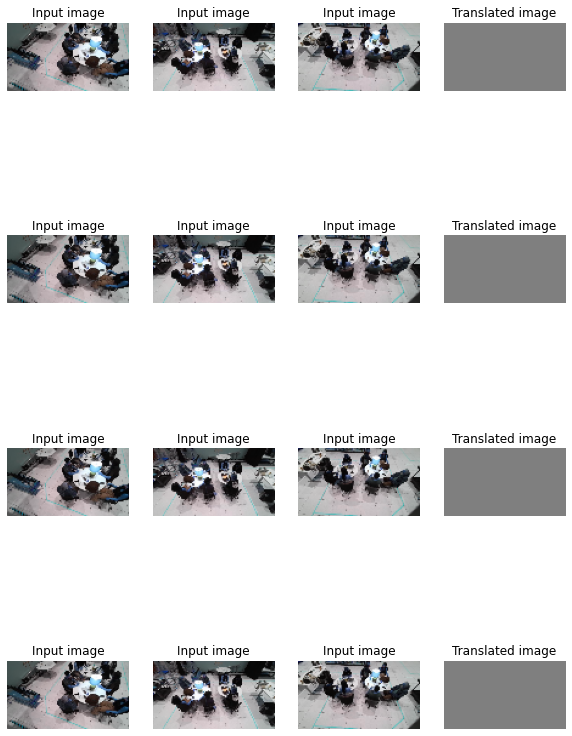

7/7 [==============================] - 84s 3s/step - X_loss: 5.6538 - Y_loss: 5.0989 - Z_loss: 5.6198 - W_loss: 4.9628 - D_X_loss: 0.2267 - D_Y_loss: 0.2198 - D_Z_loss: 0.2290 - D_W_loss: 0.2264
Epoch 2/50
7/7 [==============================] - ETA: 0s - X_loss: 5.6437 - Y_loss: 5.1001 - Z_loss: 5.6183 - W_loss: 4.9552 - D_X_loss: 0.1600 - D_Y_loss: 0.1455 - D_Z_loss: 0.1620 - D_W_loss: 0.1561

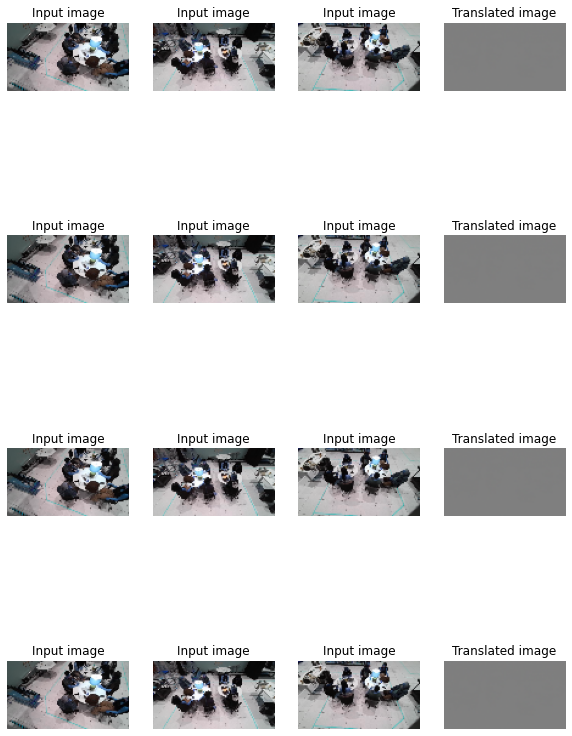

7/7 [==============================] - 12s 2s/step - X_loss: 5.6430 - Y_loss: 5.1022 - Z_loss: 5.6196 - W_loss: 4.9565 - D_X_loss: 0.1566 - D_Y_loss: 0.1420 - D_Z_loss: 0.1579 - D_W_loss: 0.1525
Epoch 3/50
7/7 [==============================] - ETA: 0s - X_loss: 5.6844 - Y_loss: 5.2597 - Z_loss: 5.7112 - W_loss: 5.0286 - D_X_loss: 0.0989 - D_Y_loss: 0.0646 - D_Z_loss: 0.0835 - D_W_loss: 0.0886

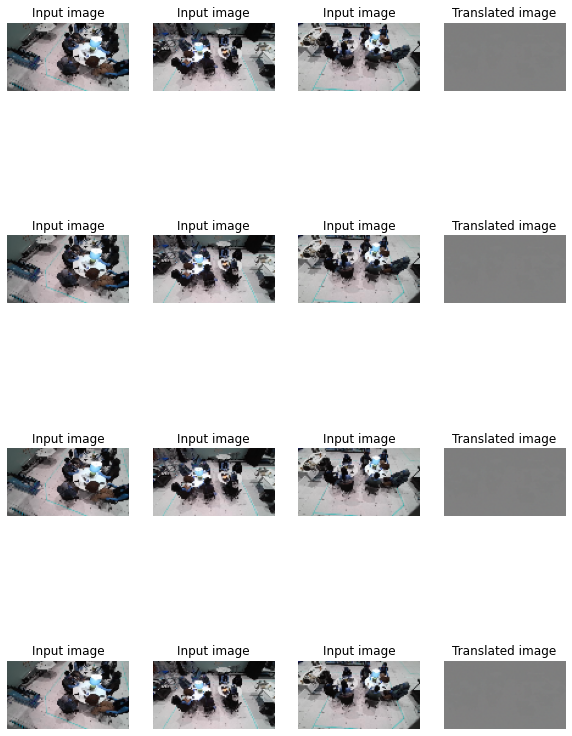

7/7 [==============================] - 12s 2s/step - X_loss: 5.6937 - Y_loss: 5.2825 - Z_loss: 5.7272 - W_loss: 5.0424 - D_X_loss: 0.0944 - D_Y_loss: 0.0591 - D_Z_loss: 0.0781 - D_W_loss: 0.0837
Epoch 4/50
7/7 [==============================] - ETA: 0s - X_loss: 5.9569 - Y_loss: 5.5691 - Z_loss: 6.0342 - W_loss: 5.3539 - D_X_loss: 0.0186 - D_Y_loss: 0.0058 - D_Z_loss: 0.0105 - D_W_loss: 0.0134

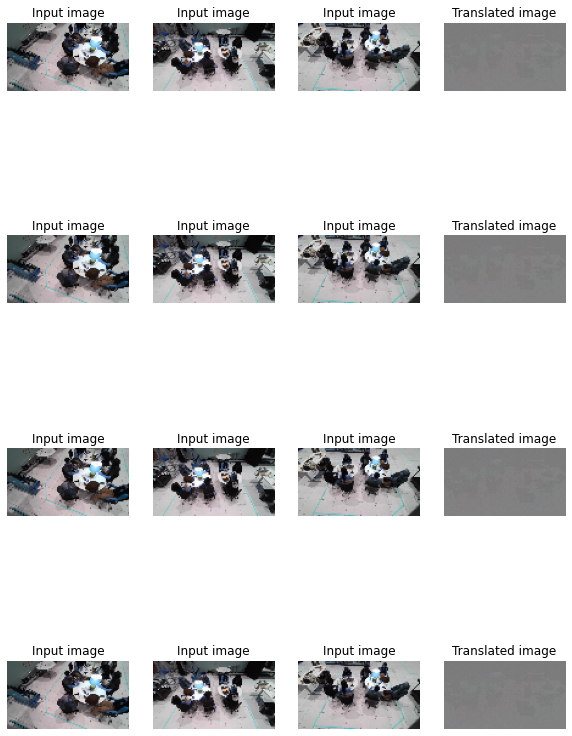

7/7 [==============================] - 12s 2s/step - X_loss: 5.9659 - Y_loss: 5.5682 - Z_loss: 6.0388 - W_loss: 5.3660 - D_X_loss: 0.0168 - D_Y_loss: 0.0054 - D_Z_loss: 0.0096 - D_W_loss: 0.0122
Epoch 5/50
7/7 [==============================] - ETA: 0s - X_loss: 5.8868 - Y_loss: 5.4305 - Z_loss: 5.9546 - W_loss: 5.3431 - D_X_loss: 0.0028 - D_Y_loss: 0.0021 - D_Z_loss: 0.0025 - D_W_loss: 0.0022

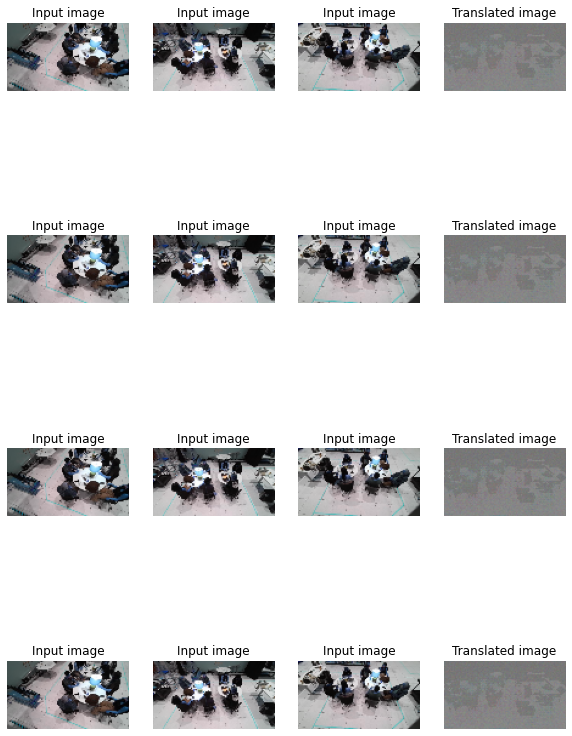

7/7 [==============================] - 12s 2s/step - X_loss: 5.8685 - Y_loss: 5.4135 - Z_loss: 5.9378 - W_loss: 5.3316 - D_X_loss: 0.0027 - D_Y_loss: 0.0021 - D_Z_loss: 0.0025 - D_W_loss: 0.0021
Epoch 6/50
7/7 [==============================] - ETA: 0s - X_loss: 5.4568 - Y_loss: 5.0140 - Z_loss: 5.5232 - W_loss: 5.0198 - D_X_loss: 0.0024 - D_Y_loss: 0.0016 - D_Z_loss: 0.0542 - D_W_loss: 0.0015

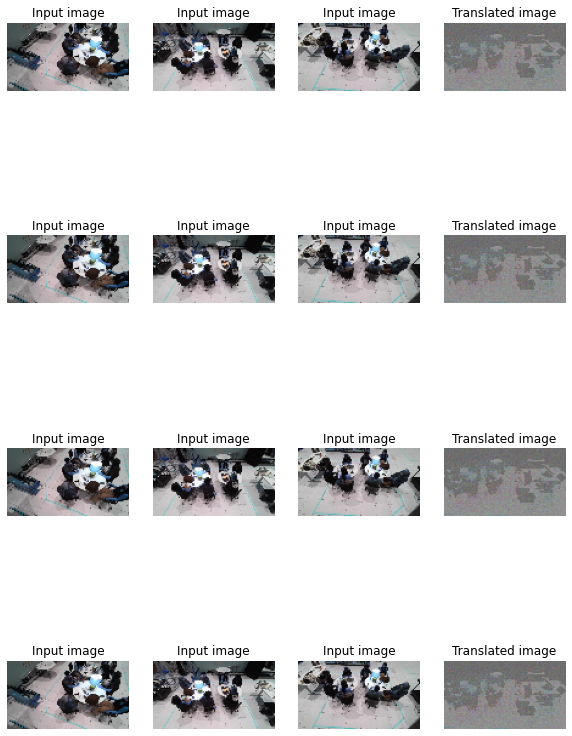

7/7 [==============================] - 12s 2s/step - X_loss: 5.4297 - Y_loss: 4.9847 - Z_loss: 5.4939 - W_loss: 4.9954 - D_X_loss: 0.0026 - D_Y_loss: 0.0016 - D_Z_loss: 0.0928 - D_W_loss: 0.0014
Epoch 7/50
7/7 [==============================] - ETA: 0s - X_loss: 4.6575 - Y_loss: 3.9896 - Z_loss: 4.5788 - W_loss: 4.4984 - D_X_loss: 0.0287 - D_Y_loss: 0.1942 - D_Z_loss: 0.0642 - D_W_loss: 0.0204

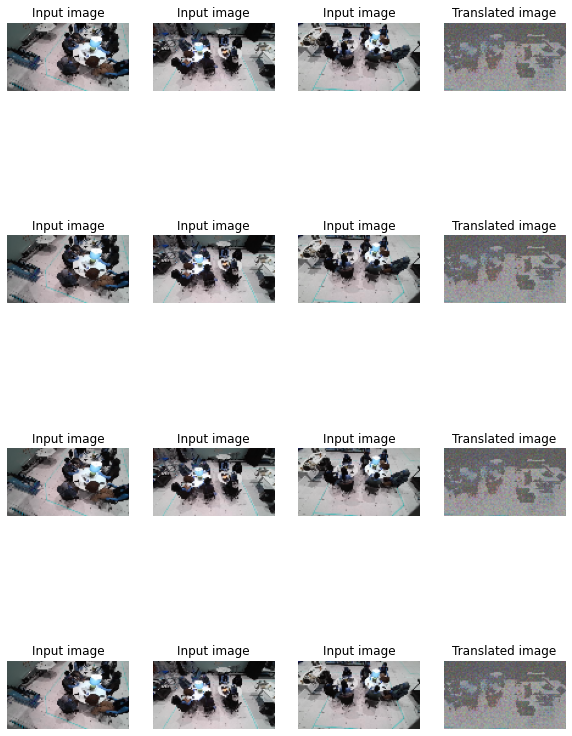

7/7 [==============================] - 12s 2s/step - X_loss: 4.6329 - Y_loss: 3.8870 - Z_loss: 4.5513 - W_loss: 4.4706 - D_X_loss: 0.0278 - D_Y_loss: 0.2229 - D_Z_loss: 0.0574 - D_W_loss: 0.0345
Epoch 8/50
7/7 [==============================] - ETA: 0s - X_loss: 3.8936 - Y_loss: 3.0008 - Z_loss: 3.8784 - W_loss: 3.4911 - D_X_loss: 0.2749 - D_Y_loss: 0.2103 - D_Z_loss: 0.0330 - D_W_loss: 0.0970

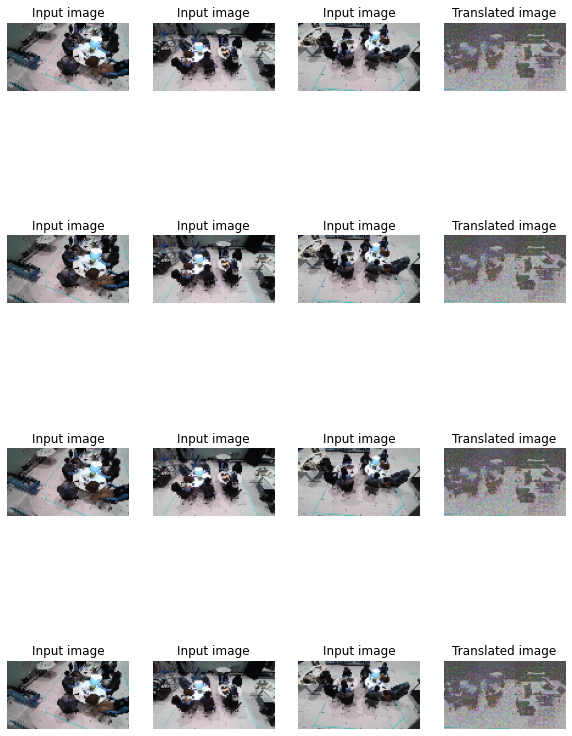

7/7 [==============================] - 12s 2s/step - X_loss: 3.8309 - Y_loss: 2.9781 - Z_loss: 3.8475 - W_loss: 3.4665 - D_X_loss: 0.2533 - D_Y_loss: 0.2009 - D_Z_loss: 0.0344 - D_W_loss: 0.0908
Epoch 9/50
7/7 [==============================] - ETA: 0s - X_loss: 3.4752 - Y_loss: 2.6260 - Z_loss: 3.3478 - W_loss: 3.2808 - D_X_loss: 0.0254 - D_Y_loss: 0.2232 - D_Z_loss: 0.3414 - D_W_loss: 0.0232

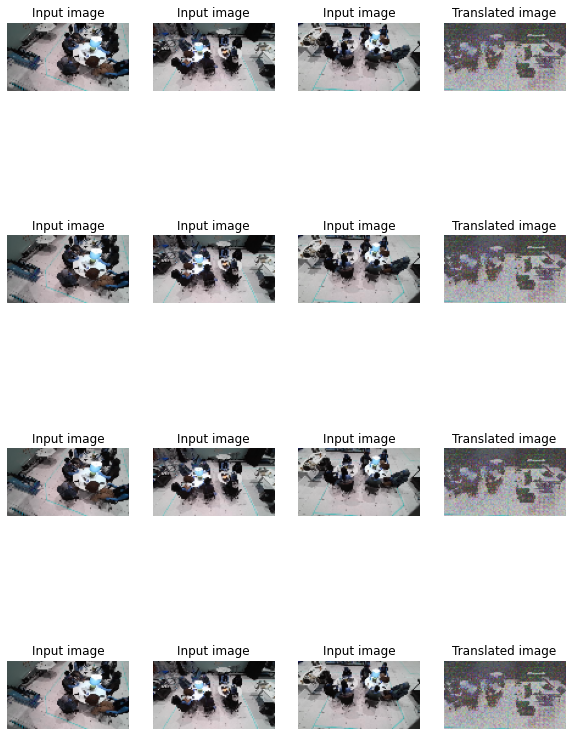

7/7 [==============================] - 12s 2s/step - X_loss: 3.4528 - Y_loss: 2.6250 - Z_loss: 3.3065 - W_loss: 3.2732 - D_X_loss: 0.0255 - D_Y_loss: 0.2190 - D_Z_loss: 0.3259 - D_W_loss: 0.0219
Epoch 10/50
7/7 [==============================] - ETA: 0s - X_loss: 3.1431 - Y_loss: 2.1793 - Z_loss: 2.5775 - W_loss: 3.1273 - D_X_loss: 0.0219 - D_Y_loss: 0.1235 - D_Z_loss: 0.1259 - D_W_loss: 0.0158

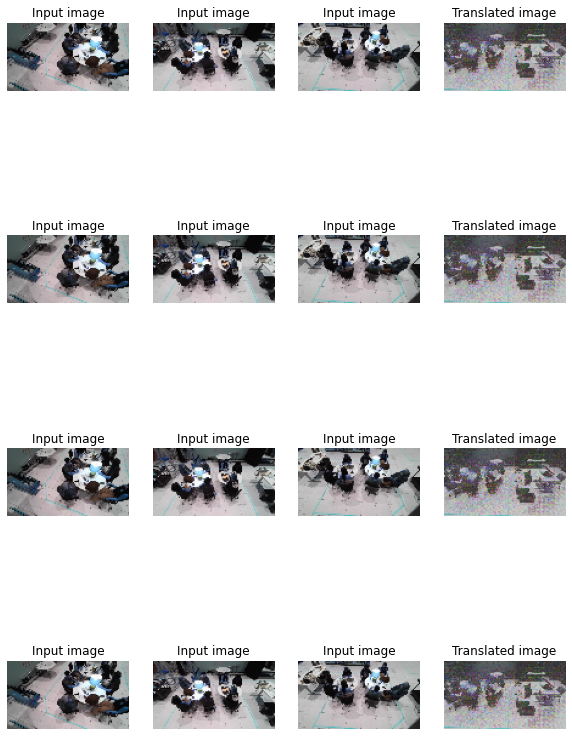

7/7 [==============================] - 12s 2s/step - X_loss: 3.1406 - Y_loss: 2.1148 - Z_loss: 2.5660 - W_loss: 3.1338 - D_X_loss: 0.0211 - D_Y_loss: 0.1499 - D_Z_loss: 0.1196 - D_W_loss: 0.0166
Epoch 11/50
7/7 [==============================] - ETA: 0s - X_loss: 2.9713 - Y_loss: 1.9451 - Z_loss: 2.3928 - W_loss: 2.9220 - D_X_loss: 0.0096 - D_Y_loss: 0.2032 - D_Z_loss: 0.0482 - D_W_loss: 0.0632

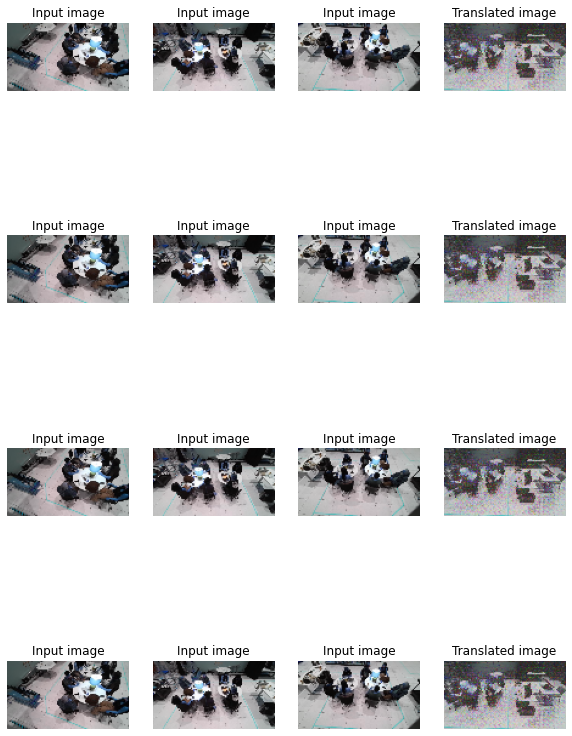

7/7 [==============================] - 12s 2s/step - X_loss: 2.9614 - Y_loss: 1.9594 - Z_loss: 2.3470 - W_loss: 2.9351 - D_X_loss: 0.0094 - D_Y_loss: 0.1954 - D_Z_loss: 0.0527 - D_W_loss: 0.0555
Epoch 12/50
7/7 [==============================] - ETA: 0s - X_loss: 2.7362 - Y_loss: 1.8289 - Z_loss: 2.1251 - W_loss: 2.7403 - D_X_loss: 0.1195 - D_Y_loss: 0.0835 - D_Z_loss: 0.0770 - D_W_loss: 0.0252

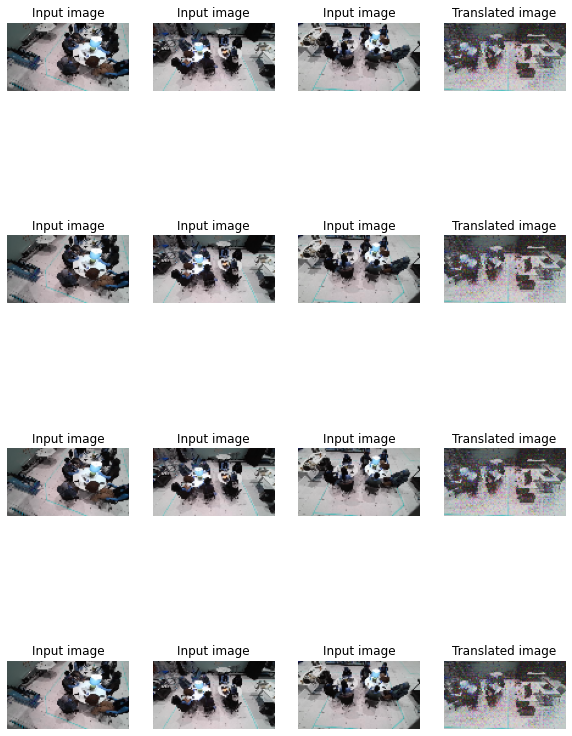

7/7 [==============================] - 12s 2s/step - X_loss: 2.6942 - Y_loss: 1.8290 - Z_loss: 2.0982 - W_loss: 2.6947 - D_X_loss: 0.1104 - D_Y_loss: 0.0815 - D_Z_loss: 0.0782 - D_W_loss: 0.0316
Epoch 13/50
7/7 [==============================] - ETA: 0s - X_loss: 2.6203 - Y_loss: 1.6980 - Z_loss: 1.9861 - W_loss: 2.7629 - D_X_loss: 0.0086 - D_Y_loss: 0.1510 - D_Z_loss: 0.0915 - D_W_loss: 0.0277

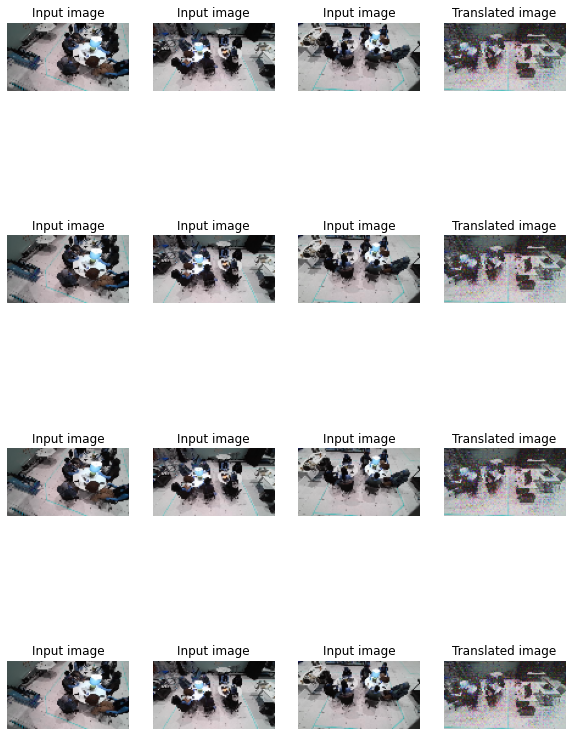

7/7 [==============================] - 12s 2s/step - X_loss: 2.6104 - Y_loss: 1.6763 - Z_loss: 1.9872 - W_loss: 2.7665 - D_X_loss: 0.0082 - D_Y_loss: 0.1428 - D_Z_loss: 0.0855 - D_W_loss: 0.0246
Epoch 14/50
7/7 [==============================] - ETA: 0s - X_loss: 2.3629 - Y_loss: 1.6603 - Z_loss: 1.8573 - W_loss: 2.6119 - D_X_loss: 0.0186 - D_Y_loss: 0.0703 - D_Z_loss: 0.1303 - D_W_loss: 0.0104

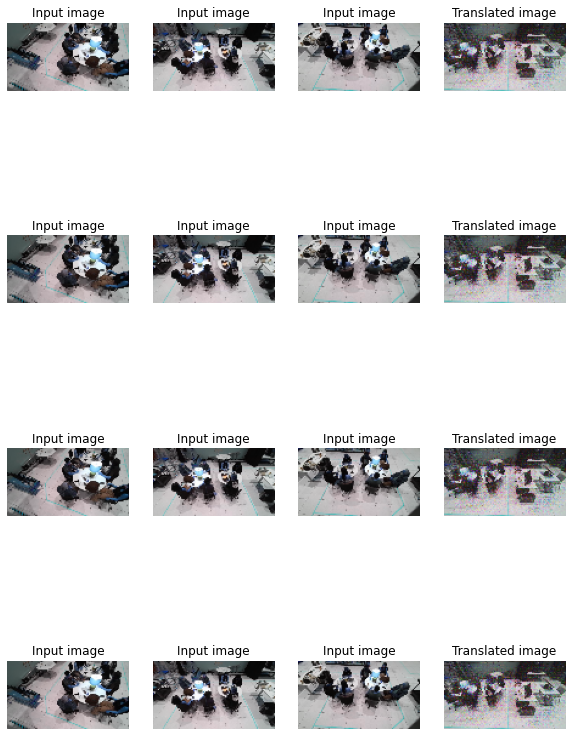

7/7 [==============================] - 12s 2s/step - X_loss: 2.3510 - Y_loss: 1.6492 - Z_loss: 1.8823 - W_loss: 2.5994 - D_X_loss: 0.0200 - D_Y_loss: 0.0702 - D_Z_loss: 0.1362 - D_W_loss: 0.0115
Epoch 15/50
7/7 [==============================] - ETA: 0s - X_loss: 2.3252 - Y_loss: 1.6094 - Z_loss: 1.7047 - W_loss: 2.5187 - D_X_loss: 0.0401 - D_Y_loss: 0.1117 - D_Z_loss: 0.1095 - D_W_loss: 0.0158

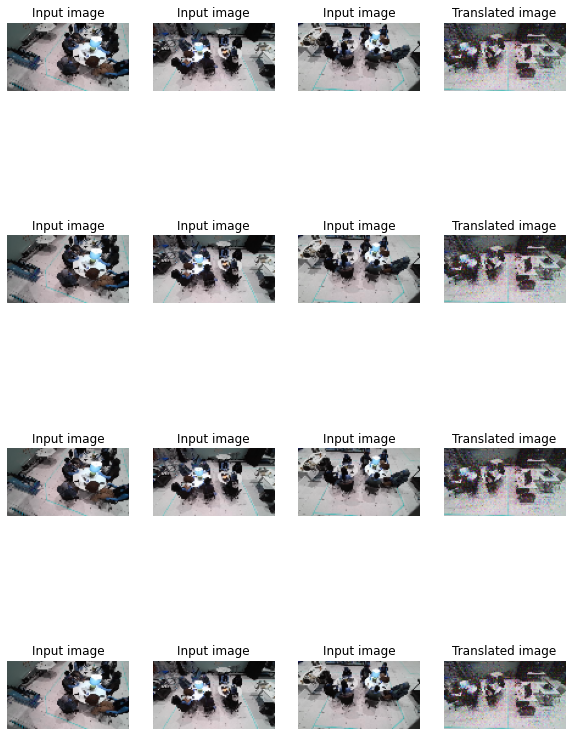

7/7 [==============================] - 12s 2s/step - X_loss: 2.3470 - Y_loss: 1.6090 - Z_loss: 1.7341 - W_loss: 2.5172 - D_X_loss: 0.0377 - D_Y_loss: 0.1064 - D_Z_loss: 0.1142 - D_W_loss: 0.0151
Epoch 16/50
7/7 [==============================] - ETA: 0s - X_loss: 2.3943 - Y_loss: 1.5359 - Z_loss: 1.6545 - W_loss: 2.5328 - D_X_loss: 0.0014 - D_Y_loss: 0.0859 - D_Z_loss: 0.1005 - D_W_loss: 0.0095

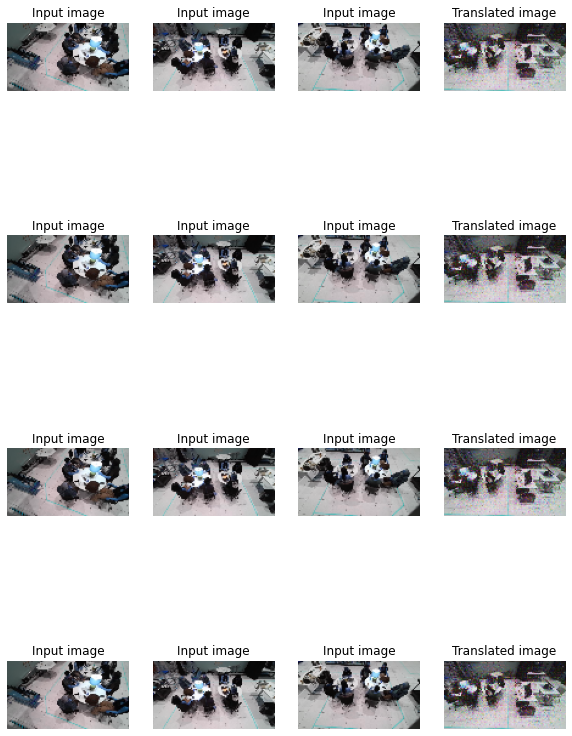

7/7 [==============================] - 12s 2s/step - X_loss: 2.3828 - Y_loss: 1.5475 - Z_loss: 1.6860 - W_loss: 2.5366 - D_X_loss: 0.0015 - D_Y_loss: 0.0813 - D_Z_loss: 0.1073 - D_W_loss: 0.0094
Epoch 17/50
7/7 [==============================] - ETA: 0s - X_loss: 2.0924 - Y_loss: 1.5271 - Z_loss: 1.5385 - W_loss: 2.5039 - D_X_loss: 0.0476 - D_Y_loss: 0.1050 - D_Z_loss: 0.0910 - D_W_loss: 0.0072

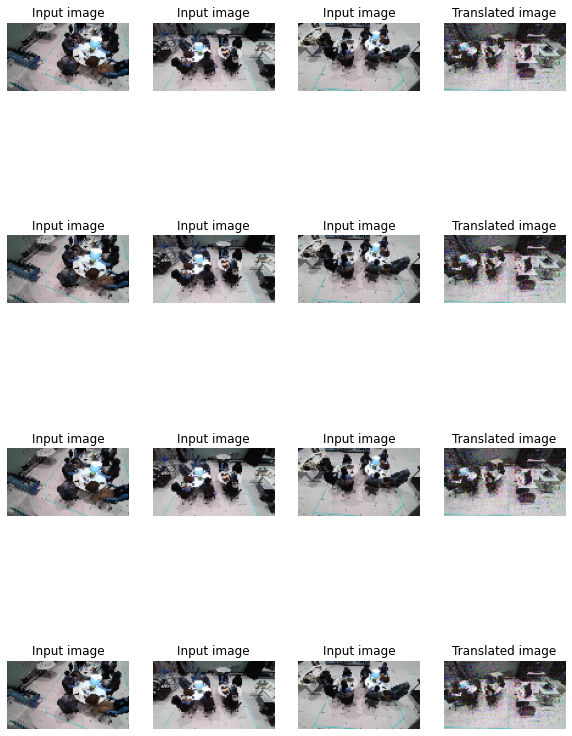

7/7 [==============================] - 12s 2s/step - X_loss: 2.1068 - Y_loss: 1.5185 - Z_loss: 1.5202 - W_loss: 2.5004 - D_X_loss: 0.0687 - D_Y_loss: 0.0997 - D_Z_loss: 0.0943 - D_W_loss: 0.0071
Epoch 18/50
7/7 [==============================] - ETA: 0s - X_loss: 1.6993 - Y_loss: 1.5797 - Z_loss: 1.4774 - W_loss: 2.4646 - D_X_loss: 0.2041 - D_Y_loss: 0.0485 - D_Z_loss: 0.1868 - D_W_loss: 0.0062

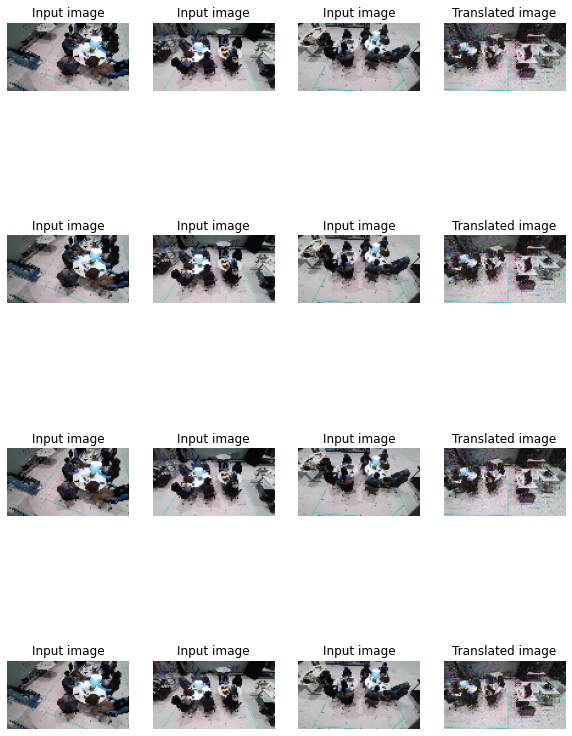

7/7 [==============================] - 12s 2s/step - X_loss: 1.7100 - Y_loss: 1.5754 - Z_loss: 1.4674 - W_loss: 2.4563 - D_X_loss: 0.1825 - D_Y_loss: 0.0485 - D_Z_loss: 0.1749 - D_W_loss: 0.0060
Epoch 19/50
7/7 [==============================] - ETA: 0s - X_loss: 1.9228 - Y_loss: 1.6050 - Z_loss: 1.4354 - W_loss: 2.3806 - D_X_loss: 0.0226 - D_Y_loss: 0.1076 - D_Z_loss: 0.1501 - D_W_loss: 0.0910

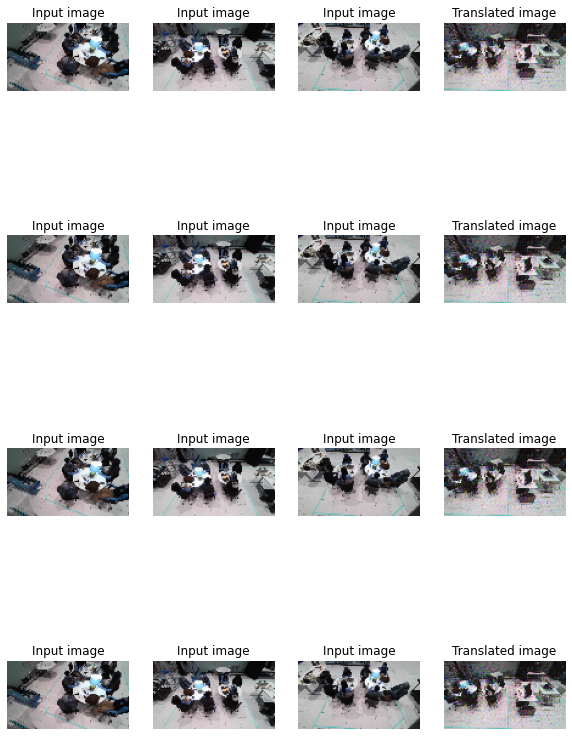

7/7 [==============================] - 12s 2s/step - X_loss: 1.9163 - Y_loss: 1.6254 - Z_loss: 1.4194 - W_loss: 2.4094 - D_X_loss: 0.0242 - D_Y_loss: 0.0997 - D_Z_loss: 0.1485 - D_W_loss: 0.1404
Epoch 20/50
7/7 [==============================] - ETA: 0s - X_loss: 1.8152 - Y_loss: 1.6355 - Z_loss: 1.4003 - W_loss: 2.5032 - D_X_loss: 0.1562 - D_Y_loss: 0.0272 - D_Z_loss: 0.1692 - D_W_loss: 0.4972

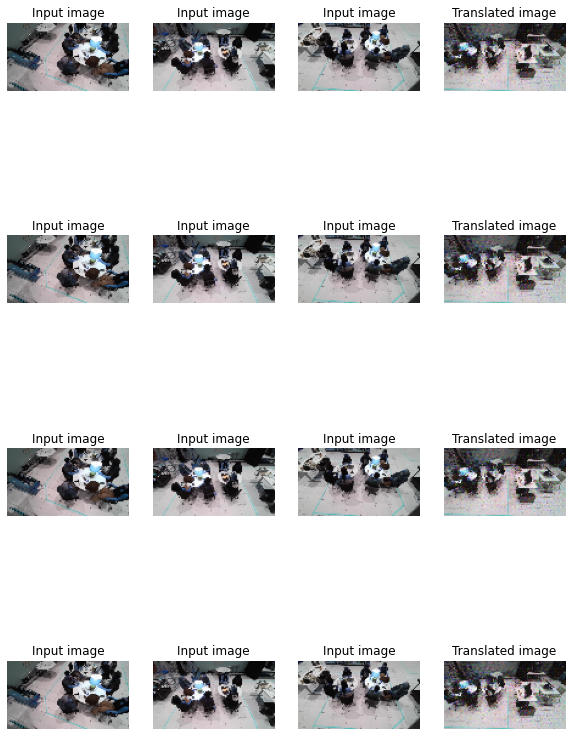

7/7 [==============================] - 12s 2s/step - X_loss: 1.8165 - Y_loss: 1.6397 - Z_loss: 1.4271 - W_loss: 2.4980 - D_X_loss: 0.1407 - D_Y_loss: 0.0270 - D_Z_loss: 0.1692 - D_W_loss: 0.4971
Epoch 21/50
7/7 [==============================] - ETA: 0s - X_loss: 1.7321 - Y_loss: 1.6419 - Z_loss: 1.2690 - W_loss: 2.3330 - D_X_loss: 0.0507 - D_Y_loss: 0.0336 - D_Z_loss: 0.1571 - D_W_loss: 0.2746

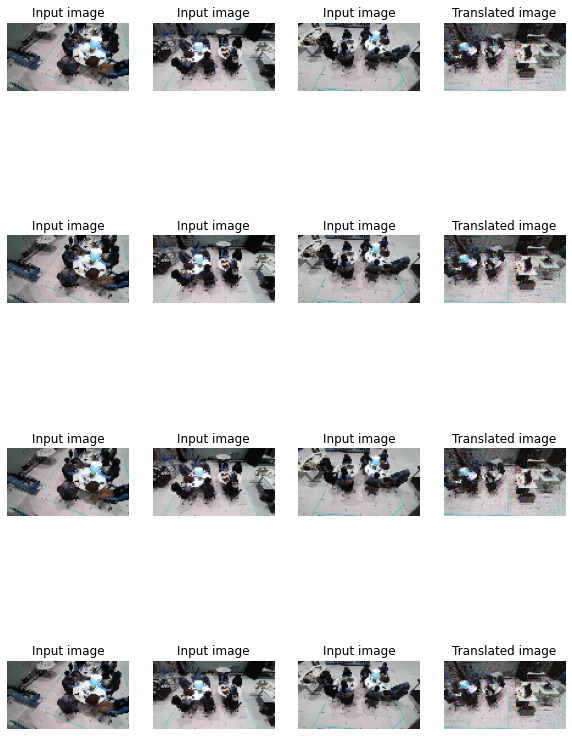

7/7 [==============================] - 12s 2s/step - X_loss: 1.6858 - Y_loss: 1.6440 - Z_loss: 1.2419 - W_loss: 2.2979 - D_X_loss: 0.0594 - D_Y_loss: 0.0346 - D_Z_loss: 0.1610 - D_W_loss: 0.2411
Epoch 22/50
7/7 [==============================] - ETA: 0s - X_loss: 1.7538 - Y_loss: 1.6865 - Z_loss: 1.2478 - W_loss: 2.0924 - D_X_loss: 0.1523 - D_Y_loss: 0.0559 - D_Z_loss: 0.1986 - D_W_loss: 0.0171

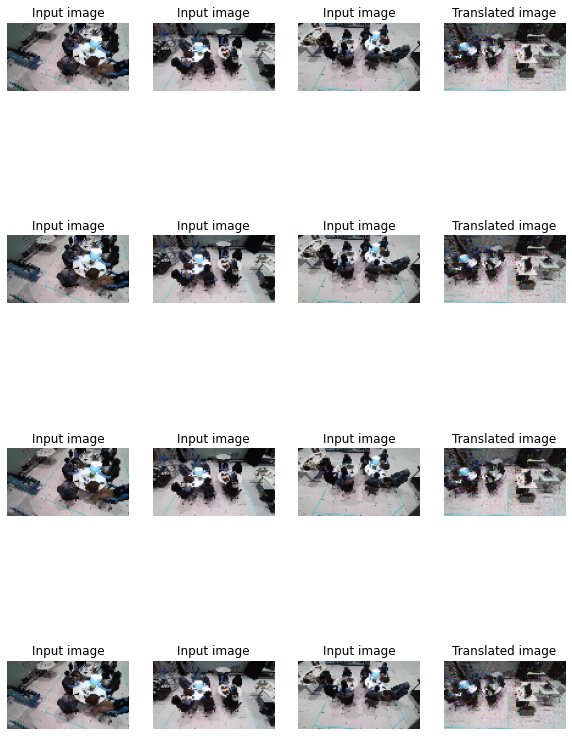

7/7 [==============================] - 12s 2s/step - X_loss: 1.7438 - Y_loss: 1.6873 - Z_loss: 1.2570 - W_loss: 2.0835 - D_X_loss: 0.1390 - D_Y_loss: 0.0506 - D_Z_loss: 0.1999 - D_W_loss: 0.0223
Epoch 23/50
7/7 [==============================] - ETA: 0s - X_loss: 1.6325 - Y_loss: 1.7628 - Z_loss: 1.1457 - W_loss: 1.8783 - D_X_loss: 0.1348 - D_Y_loss: 0.0098 - D_Z_loss: 0.1925 - D_W_loss: 0.1347

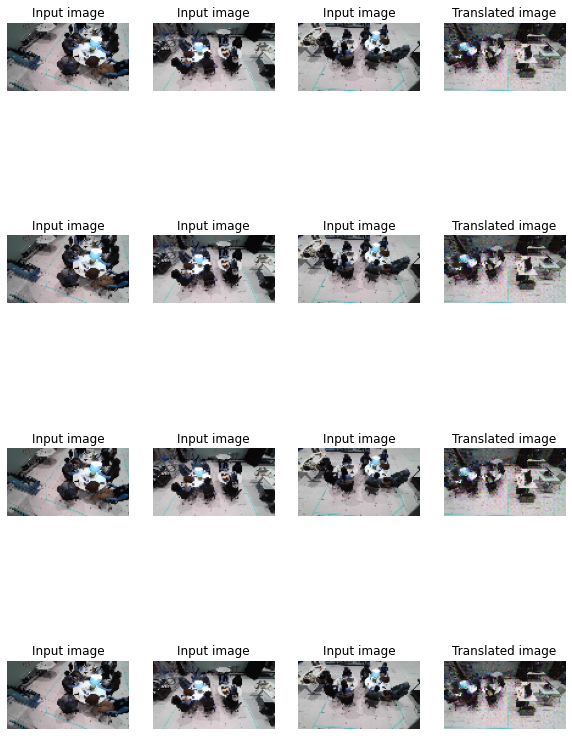

7/7 [==============================] - 12s 2s/step - X_loss: 1.6697 - Y_loss: 1.7636 - Z_loss: 1.1417 - W_loss: 1.9288 - D_X_loss: 0.1287 - D_Y_loss: 0.0095 - D_Z_loss: 0.1889 - D_W_loss: 0.1198
Epoch 24/50
7/7 [==============================] - ETA: 0s - X_loss: 1.5419 - Y_loss: 1.7257 - Z_loss: 1.1447 - W_loss: 2.0599 - D_X_loss: 0.0929 - D_Y_loss: 0.0121 - D_Z_loss: 0.2109 - D_W_loss: 0.0184

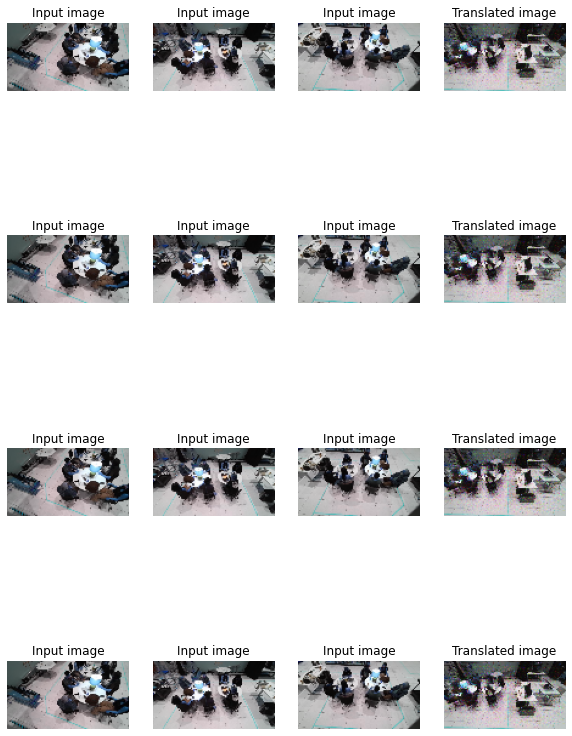

7/7 [==============================] - 12s 2s/step - X_loss: 1.5119 - Y_loss: 1.7252 - Z_loss: 1.1680 - W_loss: 2.0501 - D_X_loss: 0.0992 - D_Y_loss: 0.0122 - D_Z_loss: 0.2100 - D_W_loss: 0.0203
Epoch 25/50
7/7 [==============================] - ETA: 0s - X_loss: 1.5828 - Y_loss: 1.7122 - Z_loss: 1.0849 - W_loss: 1.7159 - D_X_loss: 0.1992 - D_Y_loss: 0.0156 - D_Z_loss: 0.2211 - D_W_loss: 0.2251

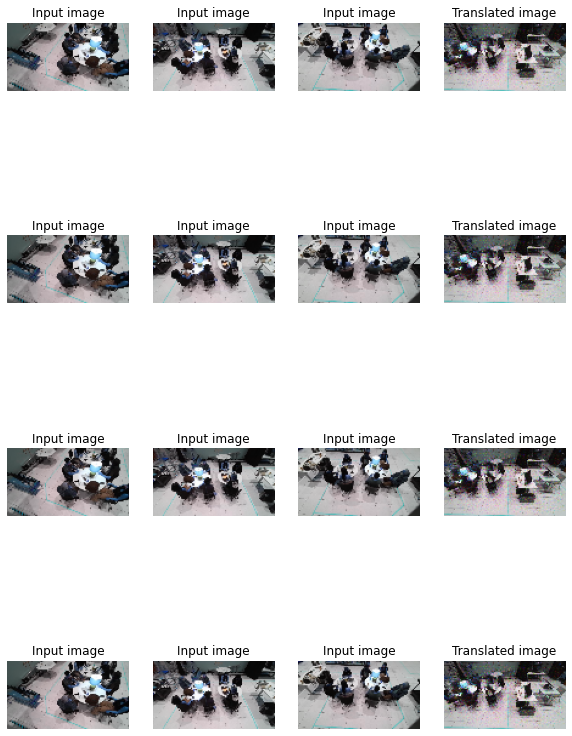

7/7 [==============================] - 12s 2s/step - X_loss: 1.6000 - Y_loss: 1.7084 - Z_loss: 1.0965 - W_loss: 1.7621 - D_X_loss: 0.2030 - D_Y_loss: 0.0153 - D_Z_loss: 0.2226 - D_W_loss: 0.1995
Epoch 26/50
7/7 [==============================] - ETA: 0s - X_loss: 1.4264 - Y_loss: 1.7726 - Z_loss: 1.0170 - W_loss: 2.0021 - D_X_loss: 0.1502 - D_Y_loss: 0.0143 - D_Z_loss: 0.2184 - D_W_loss: 0.0052

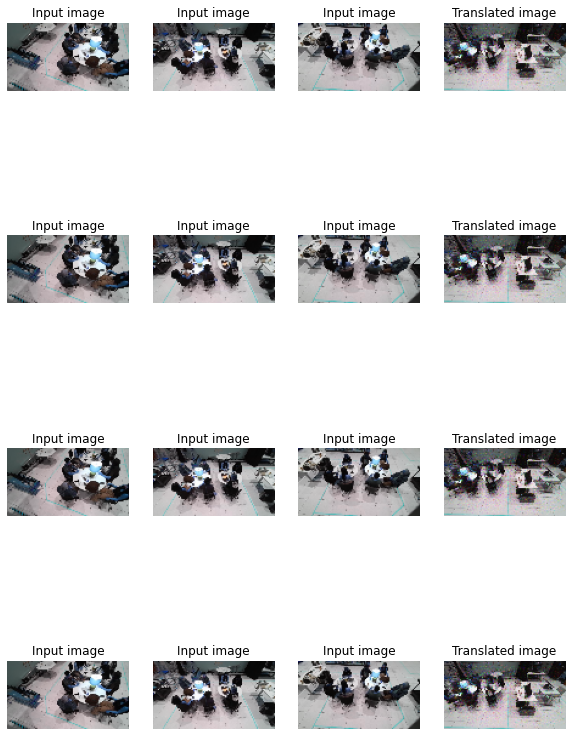

7/7 [==============================] - 12s 2s/step - X_loss: 1.4539 - Y_loss: 1.7878 - Z_loss: 1.0082 - W_loss: 2.0077 - D_X_loss: 0.1370 - D_Y_loss: 0.0132 - D_Z_loss: 0.2181 - D_W_loss: 0.0055
Epoch 27/50
7/7 [==============================] - ETA: 0s - X_loss: 1.3624 - Y_loss: 1.8204 - Z_loss: 1.0260 - W_loss: 1.7443 - D_X_loss: 0.1617 - D_Y_loss: 0.0087 - D_Z_loss: 0.2144 - D_W_loss: 0.1148

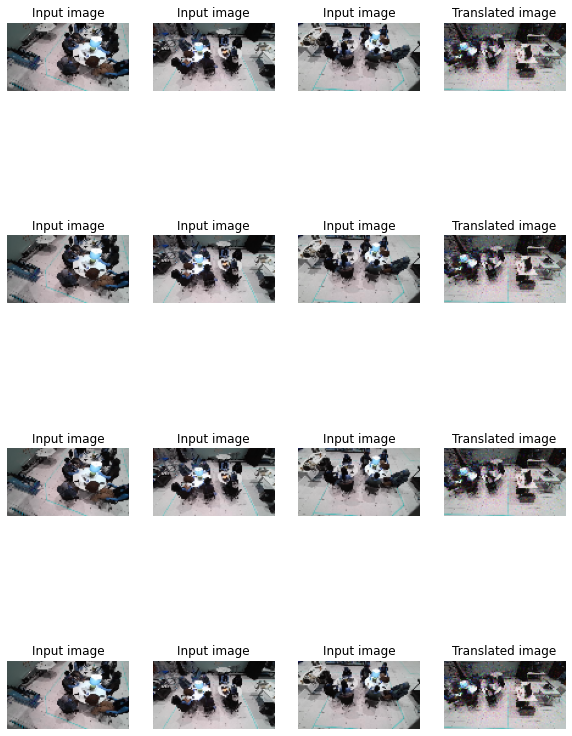

7/7 [==============================] - 12s 2s/step - X_loss: 1.3753 - Y_loss: 1.8227 - Z_loss: 1.0225 - W_loss: 1.6714 - D_X_loss: 0.1611 - D_Y_loss: 0.0081 - D_Z_loss: 0.2143 - D_W_loss: 0.1525
Epoch 28/50
7/7 [==============================] - ETA: 0s - X_loss: 1.3879 - Y_loss: 1.8089 - Z_loss: 0.9950 - W_loss: 1.8354 - D_X_loss: 0.1673 - D_Y_loss: 0.0049 - D_Z_loss: 0.2054 - D_W_loss: 0.0826

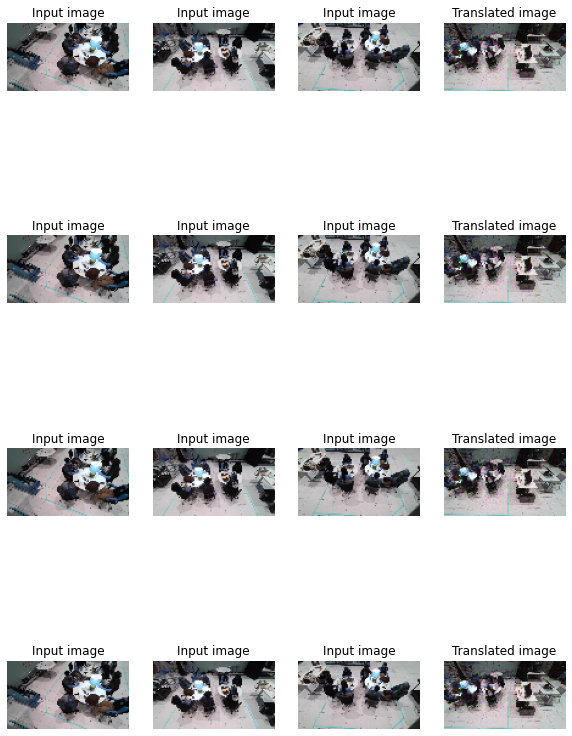

7/7 [==============================] - 12s 2s/step - X_loss: 1.3978 - Y_loss: 1.8084 - Z_loss: 1.0002 - W_loss: 1.8525 - D_X_loss: 0.1597 - D_Y_loss: 0.0049 - D_Z_loss: 0.2014 - D_W_loss: 0.0726
Epoch 29/50
7/7 [==============================] - ETA: 0s - X_loss: 1.3766 - Y_loss: 1.7815 - Z_loss: 0.9464 - W_loss: 1.8143 - D_X_loss: 0.1584 - D_Y_loss: 0.0067 - D_Z_loss: 0.2248 - D_W_loss: 0.0229

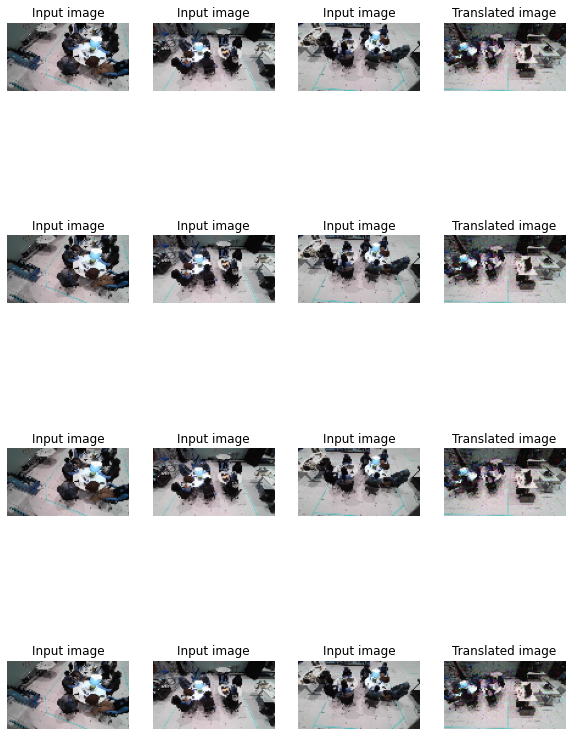

7/7 [==============================] - 12s 2s/step - X_loss: 1.4028 - Y_loss: 1.7690 - Z_loss: 0.9355 - W_loss: 1.8035 - D_X_loss: 0.1558 - D_Y_loss: 0.0070 - D_Z_loss: 0.2238 - D_W_loss: 0.0279
Epoch 30/50
7/7 [==============================] - ETA: 0s - X_loss: 1.2930 - Y_loss: 1.8012 - Z_loss: 0.9703 - W_loss: 1.7617 - D_X_loss: 0.1456 - D_Y_loss: 0.0104 - D_Z_loss: 0.1890 - D_W_loss: 0.3433

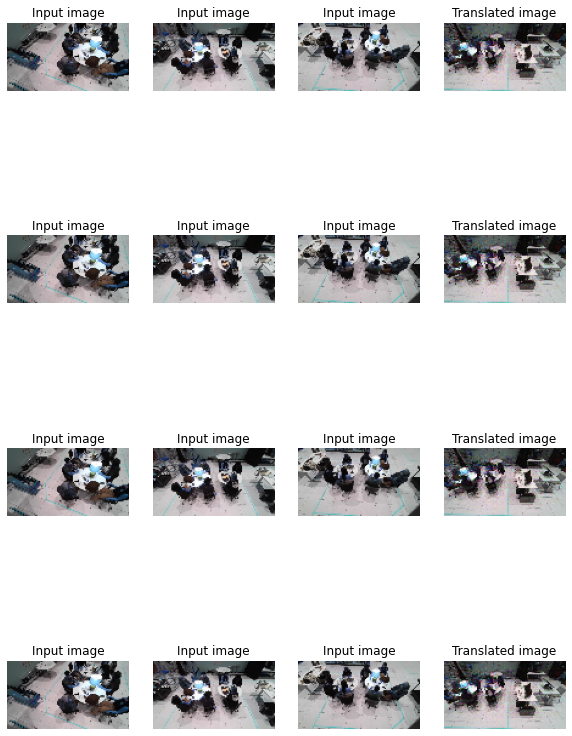

7/7 [==============================] - 12s 2s/step - X_loss: 1.2642 - Y_loss: 1.8156 - Z_loss: 0.9715 - W_loss: 1.6767 - D_X_loss: 0.1553 - D_Y_loss: 0.0112 - D_Z_loss: 0.1832 - D_W_loss: 0.3472
Epoch 31/50
7/7 [==============================] - ETA: 0s - X_loss: 1.4021 - Y_loss: 1.8130 - Z_loss: 0.9520 - W_loss: 1.6675 - D_X_loss: 0.1751 - D_Y_loss: 0.0038 - D_Z_loss: 0.1950 - D_W_loss: 0.0846

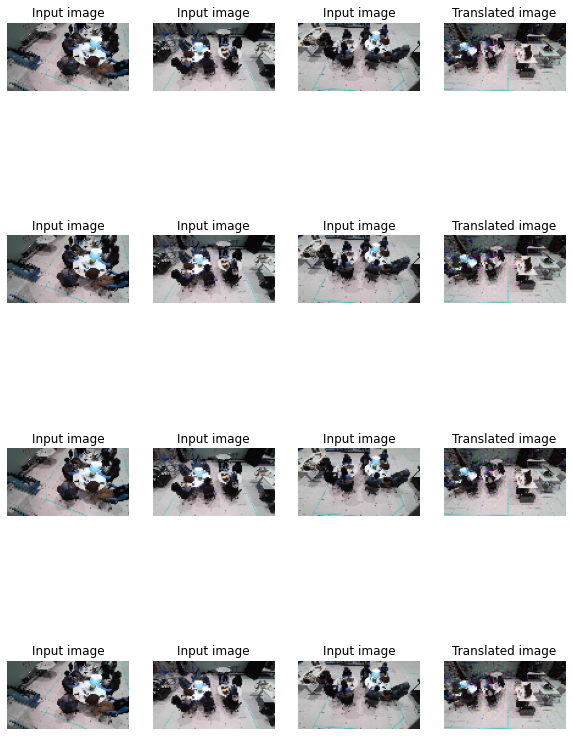

7/7 [==============================] - 12s 2s/step - X_loss: 1.4338 - Y_loss: 1.8180 - Z_loss: 0.9338 - W_loss: 1.6853 - D_X_loss: 0.1647 - D_Y_loss: 0.0037 - D_Z_loss: 0.1957 - D_W_loss: 0.0803
Epoch 32/50
7/7 [==============================] - ETA: 0s - X_loss: 1.3292 - Y_loss: 1.8062 - Z_loss: 0.9497 - W_loss: 1.5181 - D_X_loss: 0.1698 - D_Y_loss: 0.0031 - D_Z_loss: 0.1906 - D_W_loss: 0.1767

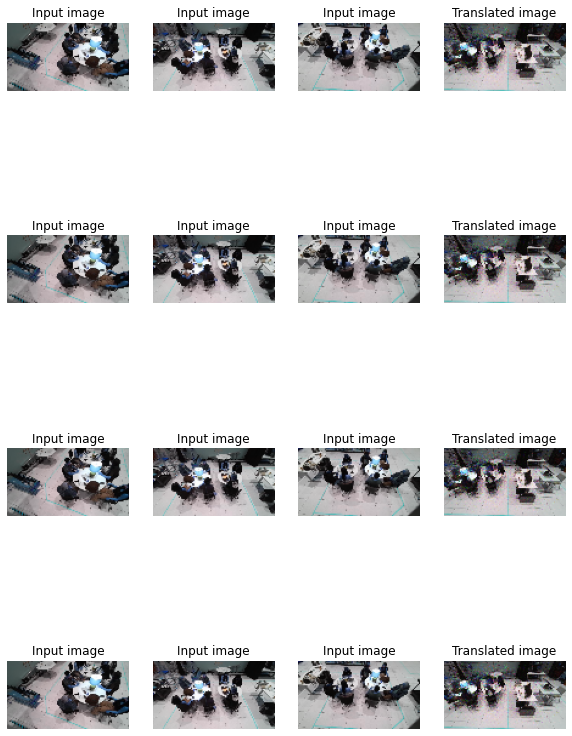

7/7 [==============================] - 12s 2s/step - X_loss: 1.3230 - Y_loss: 1.8082 - Z_loss: 0.9364 - W_loss: 1.5642 - D_X_loss: 0.1615 - D_Y_loss: 0.0031 - D_Z_loss: 0.1881 - D_W_loss: 0.1791
Epoch 33/50
7/7 [==============================] - ETA: 0s - X_loss: 1.2674 - Y_loss: 1.7852 - Z_loss: 0.9645 - W_loss: 1.5262 - D_X_loss: 0.1486 - D_Y_loss: 0.0041 - D_Z_loss: 0.1817 - D_W_loss: 0.1074

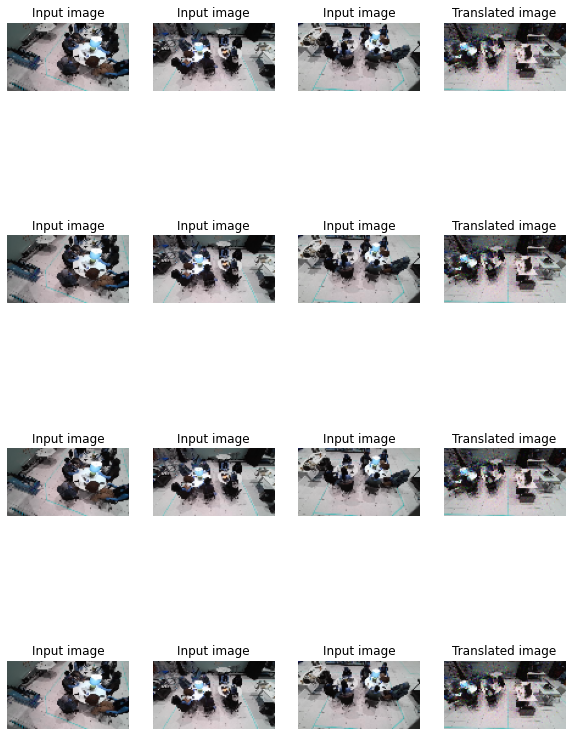

7/7 [==============================] - 12s 2s/step - X_loss: 1.2874 - Y_loss: 1.7950 - Z_loss: 0.9624 - W_loss: 1.5192 - D_X_loss: 0.1463 - D_Y_loss: 0.0039 - D_Z_loss: 0.1798 - D_W_loss: 0.1050
Epoch 34/50
7/7 [==============================] - ETA: 0s - X_loss: 1.3280 - Y_loss: 1.7738 - Z_loss: 1.0119 - W_loss: 1.6102 - D_X_loss: 0.2052 - D_Y_loss: 0.0056 - D_Z_loss: 0.1737 - D_W_loss: 0.1435

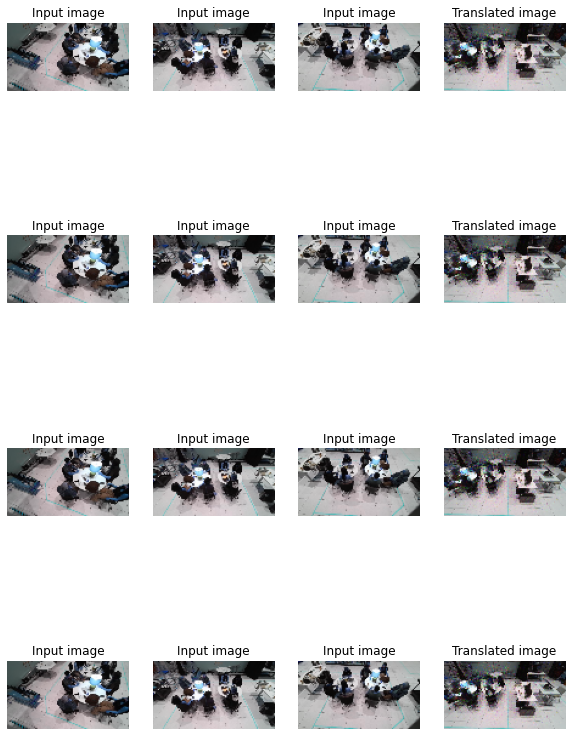

7/7 [==============================] - 12s 2s/step - X_loss: 1.2912 - Y_loss: 1.7724 - Z_loss: 1.0162 - W_loss: 1.6198 - D_X_loss: 0.2028 - D_Y_loss: 0.0054 - D_Z_loss: 0.1698 - D_W_loss: 0.1287
Epoch 35/50
7/7 [==============================] - ETA: 0s - X_loss: 1.3463 - Y_loss: 1.7783 - Z_loss: 0.9620 - W_loss: 1.5536 - D_X_loss: 0.1288 - D_Y_loss: 0.0057 - D_Z_loss: 0.1447 - D_W_loss: 0.1136

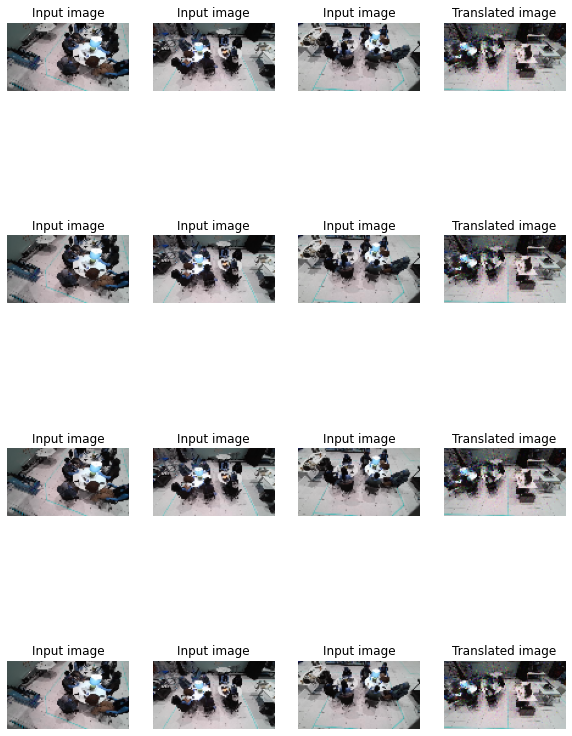

7/7 [==============================] - 12s 2s/step - X_loss: 1.3845 - Y_loss: 1.7807 - Z_loss: 0.9480 - W_loss: 1.5816 - D_X_loss: 0.1381 - D_Y_loss: 0.0054 - D_Z_loss: 0.1437 - D_W_loss: 0.1110
Epoch 36/50
7/7 [==============================] - ETA: 0s - X_loss: 1.3084 - Y_loss: 1.7996 - Z_loss: 0.9759 - W_loss: 1.5137 - D_X_loss: 0.1812 - D_Y_loss: 0.0104 - D_Z_loss: 0.1580 - D_W_loss: 0.1382

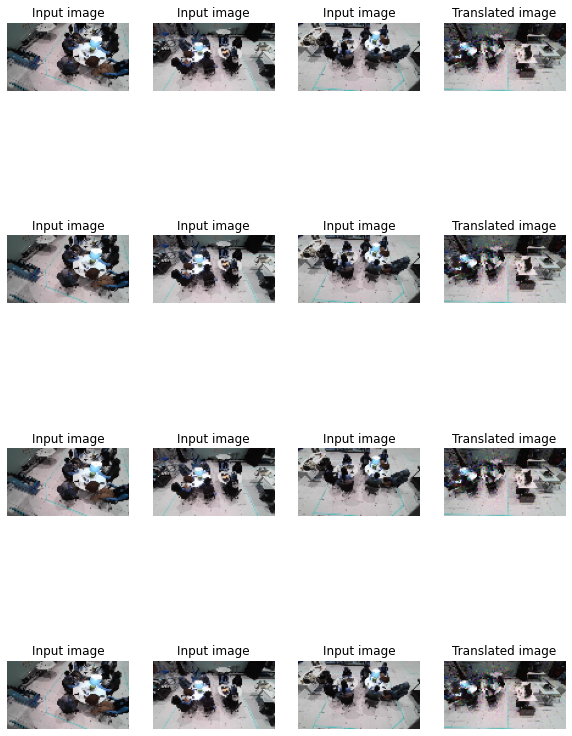

7/7 [==============================] - 12s 2s/step - X_loss: 1.3180 - Y_loss: 1.8060 - Z_loss: 0.9456 - W_loss: 1.5272 - D_X_loss: 0.1687 - D_Y_loss: 0.0095 - D_Z_loss: 0.1638 - D_W_loss: 0.1285
Epoch 37/50
7/7 [==============================] - ETA: 0s - X_loss: 1.2672 - Y_loss: 1.8301 - Z_loss: 1.0390 - W_loss: 1.5201 - D_X_loss: 0.1506 - D_Y_loss: 0.0024 - D_Z_loss: 0.1365 - D_W_loss: 0.1423

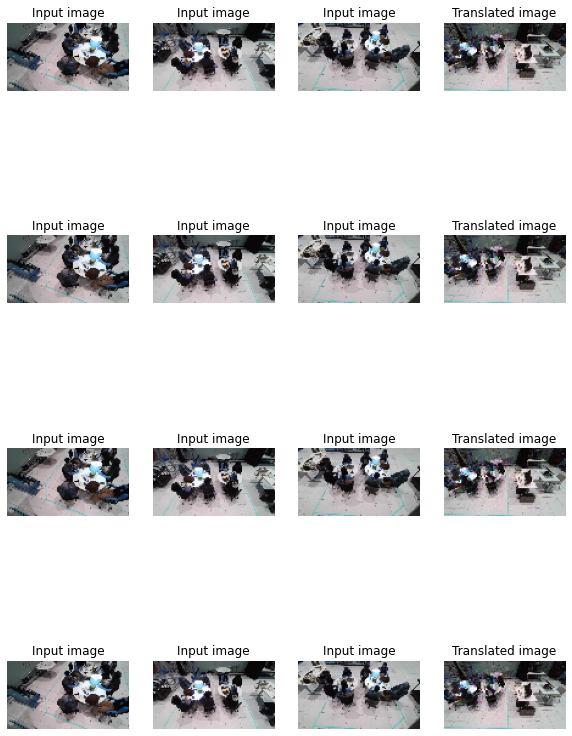

7/7 [==============================] - 12s 2s/step - X_loss: 1.2177 - Y_loss: 1.8283 - Z_loss: 1.0436 - W_loss: 1.5236 - D_X_loss: 0.1623 - D_Y_loss: 0.0024 - D_Z_loss: 0.1295 - D_W_loss: 0.1354
Epoch 38/50
7/7 [==============================] - ETA: 0s - X_loss: 1.3012 - Y_loss: 1.7935 - Z_loss: 1.0878 - W_loss: 1.5713 - D_X_loss: 0.1190 - D_Y_loss: 0.0044 - D_Z_loss: 0.1462 - D_W_loss: 0.1611

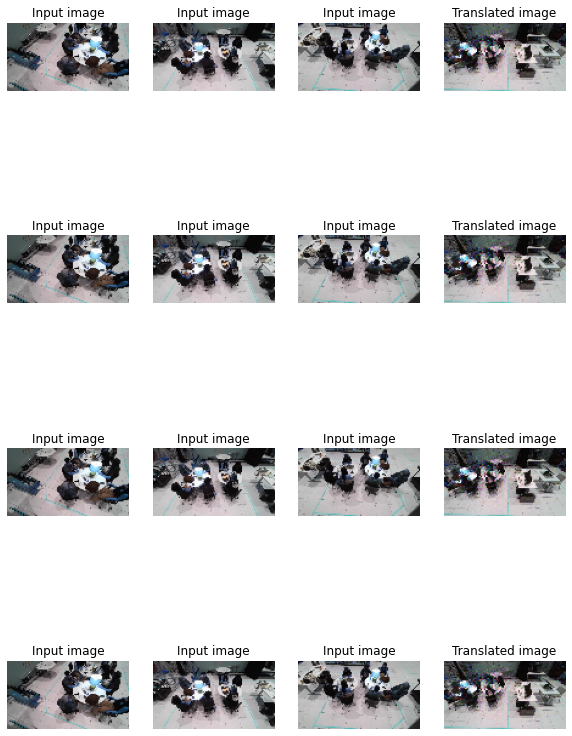

7/7 [==============================] - 12s 2s/step - X_loss: 1.3044 - Y_loss: 1.7927 - Z_loss: 1.1049 - W_loss: 1.6080 - D_X_loss: 0.1217 - D_Y_loss: 0.0042 - D_Z_loss: 0.1501 - D_W_loss: 0.1621
Epoch 39/50
7/7 [==============================] - ETA: 0s - X_loss: 1.2592 - Y_loss: 1.8065 - Z_loss: 1.0380 - W_loss: 1.5869 - D_X_loss: 0.1688 - D_Y_loss: 0.1371 - D_Z_loss: 0.0928 - D_W_loss: 0.1387

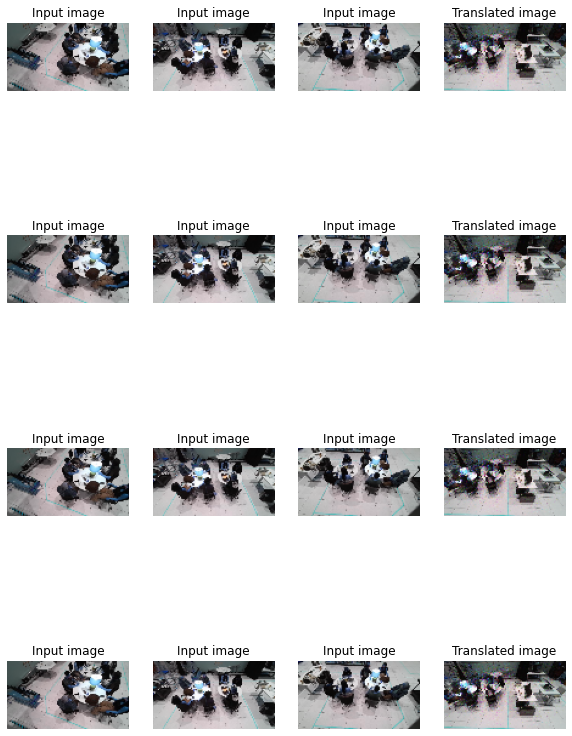

7/7 [==============================] - 12s 2s/step - X_loss: 1.2066 - Y_loss: 1.8072 - Z_loss: 1.0197 - W_loss: 1.6009 - D_X_loss: 0.1726 - D_Y_loss: 0.1421 - D_Z_loss: 0.0942 - D_W_loss: 0.1393
Epoch 40/50
7/7 [==============================] - ETA: 0s - X_loss: 1.3261 - Y_loss: 1.7730 - Z_loss: 1.0888 - W_loss: 1.5291 - D_X_loss: 0.1076 - D_Y_loss: 0.0066 - D_Z_loss: 0.1246 - D_W_loss: 0.1728

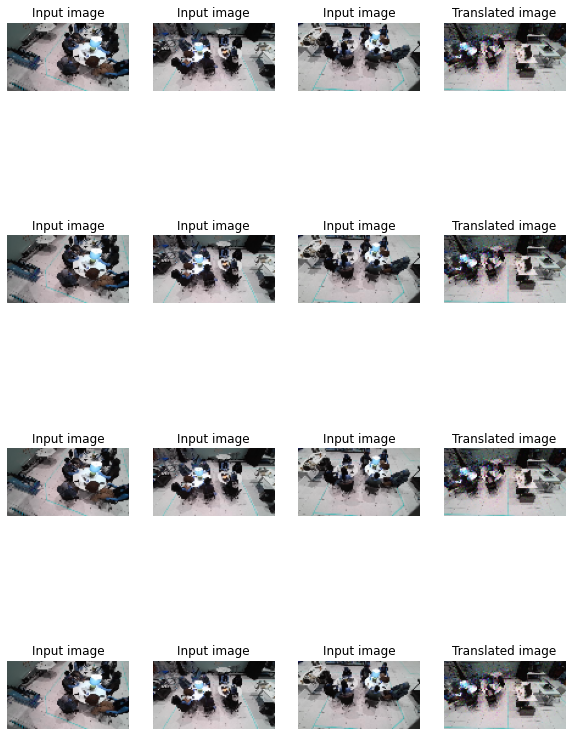

7/7 [==============================] - 12s 2s/step - X_loss: 1.3643 - Y_loss: 1.7824 - Z_loss: 1.1256 - W_loss: 1.5445 - D_X_loss: 0.1076 - D_Y_loss: 0.0058 - D_Z_loss: 0.1184 - D_W_loss: 0.1538
Epoch 41/50
7/7 [==============================] - ETA: 0s - X_loss: 1.3037 - Y_loss: 1.7892 - Z_loss: 1.1357 - W_loss: 1.5284 - D_X_loss: 0.1247 - D_Y_loss: 6.5516e-04 - D_Z_loss: 0.0743 - D_W_loss: 0.0908

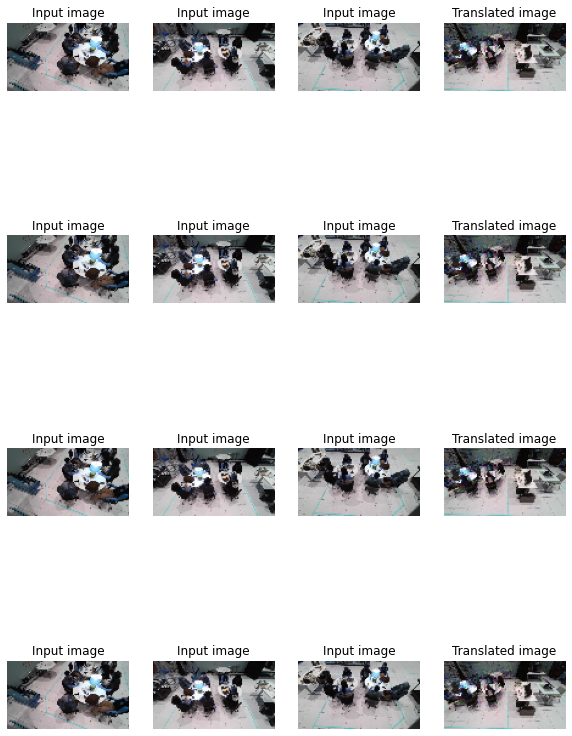

7/7 [==============================] - 12s 2s/step - X_loss: 1.3026 - Y_loss: 1.7882 - Z_loss: 1.1524 - W_loss: 1.4828 - D_X_loss: 0.1195 - D_Y_loss: 6.3585e-04 - D_Z_loss: 0.0734 - D_W_loss: 0.1004
Epoch 42/50
7/7 [==============================] - ETA: 0s - X_loss: 1.2248 - Y_loss: 1.7270 - Z_loss: 1.1227 - W_loss: 1.4902 - D_X_loss: 0.1255 - D_Y_loss: 0.0010 - D_Z_loss: 0.1021 - D_W_loss: 0.1247

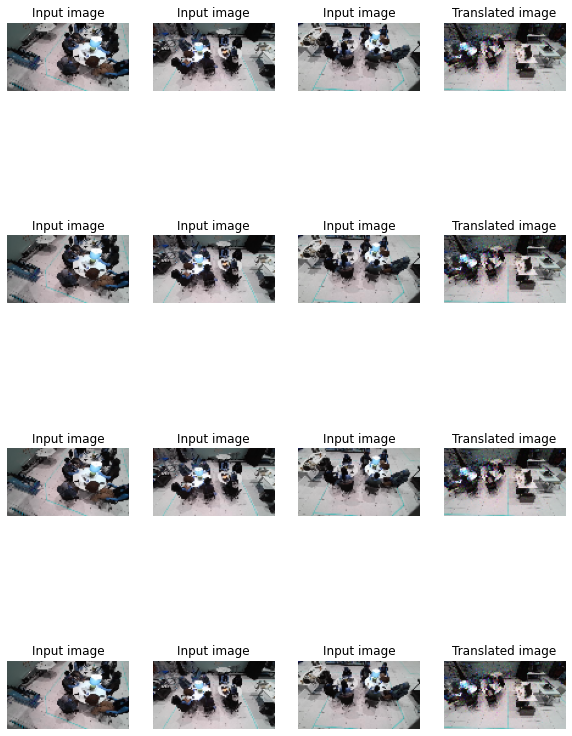

7/7 [==============================] - 12s 2s/step - X_loss: 1.1934 - Y_loss: 1.7176 - Z_loss: 1.1439 - W_loss: 1.4354 - D_X_loss: 0.1248 - D_Y_loss: 0.0010 - D_Z_loss: 0.0908 - D_W_loss: 0.1389
Epoch 43/50
7/7 [==============================] - ETA: 0s - X_loss: 1.3069 - Y_loss: 1.6841 - Z_loss: 1.1197 - W_loss: 1.6522 - D_X_loss: 0.1384 - D_Y_loss: 0.0022 - D_Z_loss: 0.1094 - D_W_loss: 0.0982

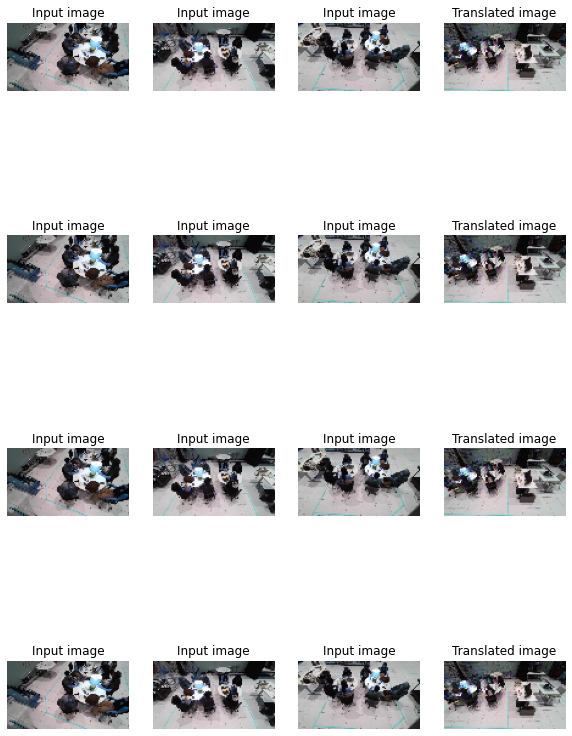

7/7 [==============================] - 12s 2s/step - X_loss: 1.3237 - Y_loss: 1.6873 - Z_loss: 1.0897 - W_loss: 1.6309 - D_X_loss: 0.1333 - D_Y_loss: 0.0021 - D_Z_loss: 0.1083 - D_W_loss: 0.0915
Epoch 44/50
7/7 [==============================] - ETA: 0s - X_loss: 1.3117 - Y_loss: 1.6645 - Z_loss: 1.1106 - W_loss: 1.4752 - D_X_loss: 0.1170 - D_Y_loss: 0.0128 - D_Z_loss: 0.0727 - D_W_loss: 0.1337

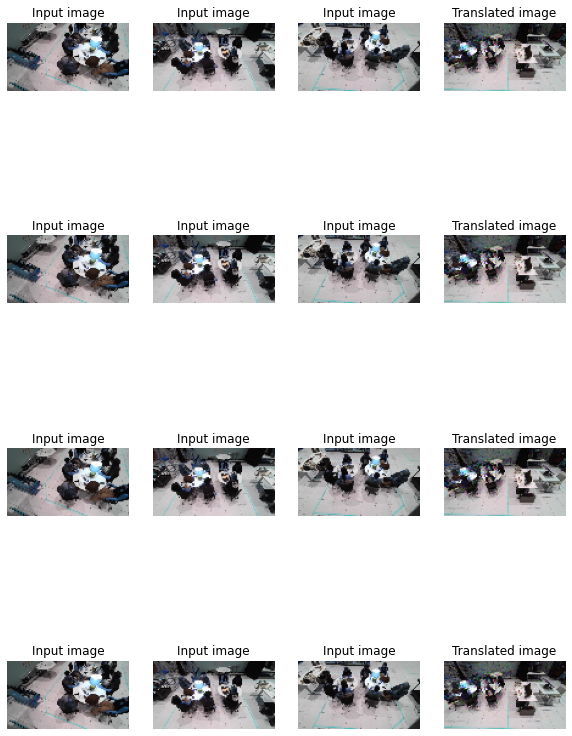

7/7 [==============================] - 12s 2s/step - X_loss: 1.3291 - Y_loss: 1.6808 - Z_loss: 1.0858 - W_loss: 1.4411 - D_X_loss: 0.1207 - D_Y_loss: 0.0125 - D_Z_loss: 0.0741 - D_W_loss: 0.1323
Epoch 45/50
7/7 [==============================] - ETA: 0s - X_loss: 1.2419 - Y_loss: 1.7035 - Z_loss: 1.1398 - W_loss: 1.5382 - D_X_loss: 0.1003 - D_Y_loss: 0.0089 - D_Z_loss: 0.0992 - D_W_loss: 0.1590

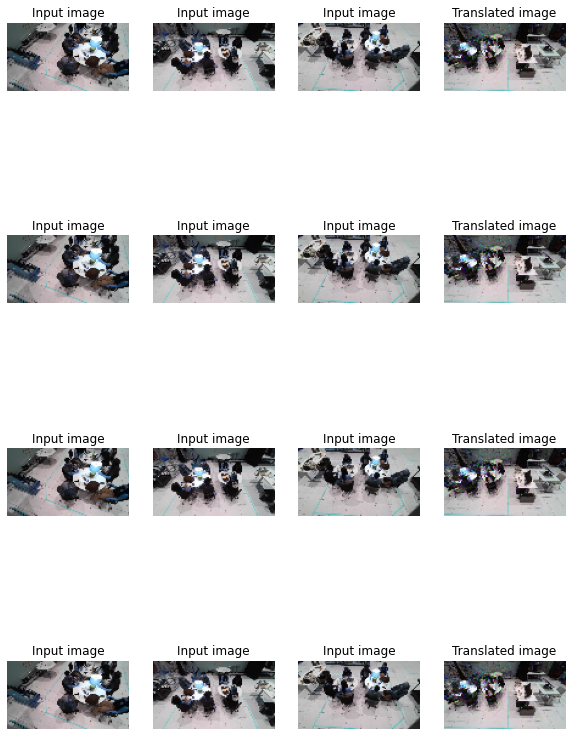

7/7 [==============================] - 12s 2s/step - X_loss: 1.2260 - Y_loss: 1.6915 - Z_loss: 1.1068 - W_loss: 1.5623 - D_X_loss: 0.0972 - D_Y_loss: 0.0081 - D_Z_loss: 0.1019 - D_W_loss: 0.1544
Epoch 46/50
7/7 [==============================] - ETA: 0s - X_loss: 1.2731 - Y_loss: 1.6732 - Z_loss: 1.0948 - W_loss: 1.5758 - D_X_loss: 0.1179 - D_Y_loss: 0.0050 - D_Z_loss: 0.1067 - D_W_loss: 0.1194

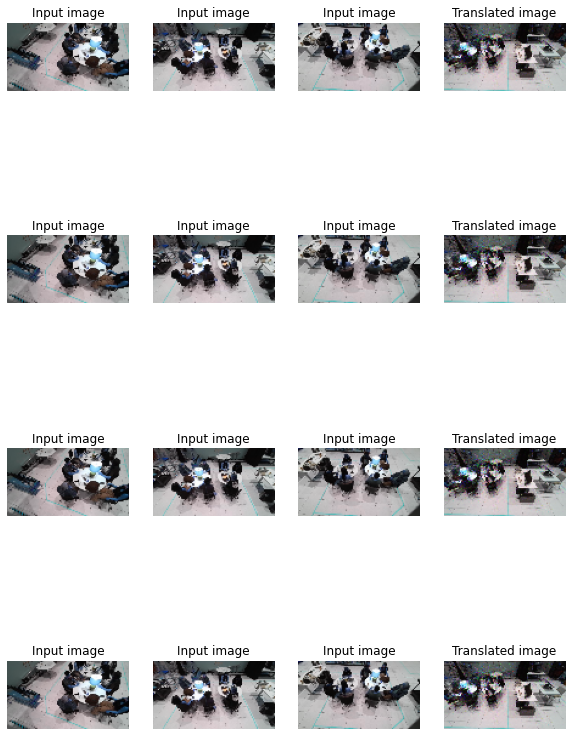

7/7 [==============================] - 12s 2s/step - X_loss: 1.2503 - Y_loss: 1.6623 - Z_loss: 1.0386 - W_loss: 1.6239 - D_X_loss: 0.1151 - D_Y_loss: 0.0055 - D_Z_loss: 0.1291 - D_W_loss: 0.1349
Epoch 47/50
7/7 [==============================] - ETA: 0s - X_loss: 1.3684 - Y_loss: 1.6723 - Z_loss: 1.2526 - W_loss: 1.5888 - D_X_loss: 0.1050 - D_Y_loss: 0.0085 - D_Z_loss: 0.1165 - D_W_loss: 0.0740

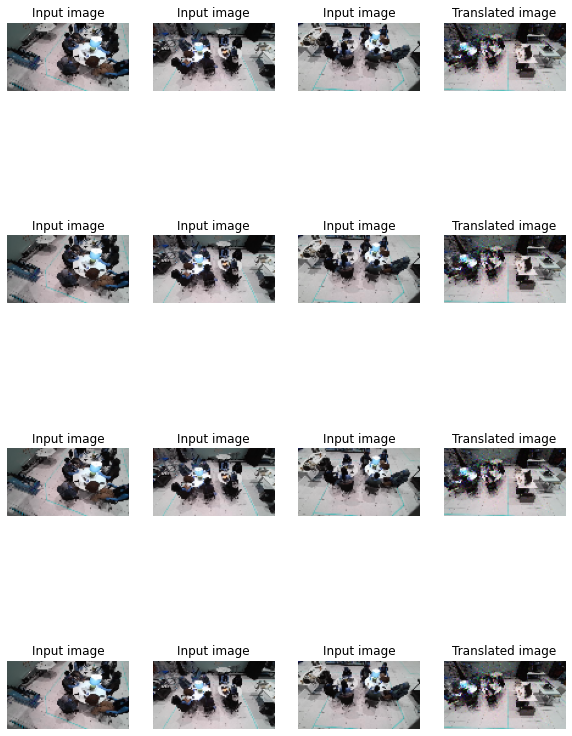

7/7 [==============================] - 12s 2s/step - X_loss: 1.3873 - Y_loss: 1.6685 - Z_loss: 1.2640 - W_loss: 1.5885 - D_X_loss: 0.0984 - D_Y_loss: 0.0079 - D_Z_loss: 0.1212 - D_W_loss: 0.0726
Epoch 48/50
7/7 [==============================] - ETA: 0s - X_loss: 1.3910 - Y_loss: 1.6970 - Z_loss: 1.1364 - W_loss: 1.4928 - D_X_loss: 0.0494 - D_Y_loss: 0.0155 - D_Z_loss: 0.0376 - D_W_loss: 0.1374

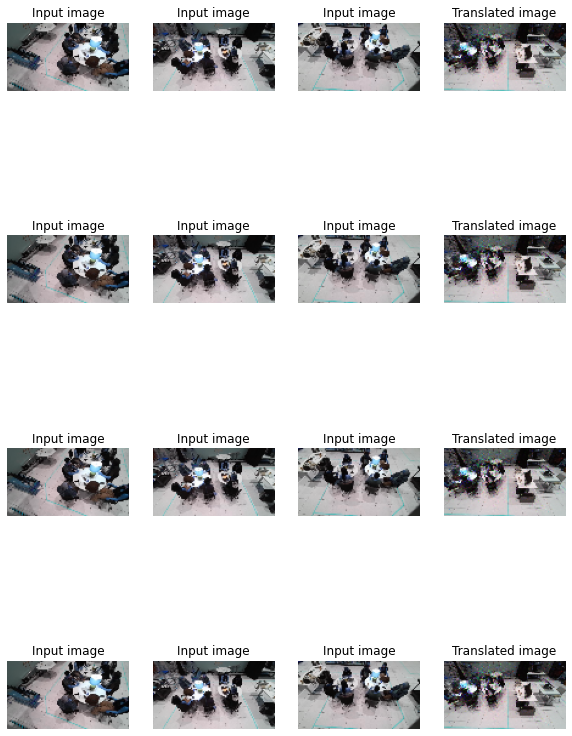

7/7 [==============================] - 12s 2s/step - X_loss: 1.4058 - Y_loss: 1.7015 - Z_loss: 1.1372 - W_loss: 1.5138 - D_X_loss: 0.0474 - D_Y_loss: 0.0146 - D_Z_loss: 0.0363 - D_W_loss: 0.1253
Epoch 49/50
7/7 [==============================] - ETA: 0s - X_loss: 1.4213 - Y_loss: 1.7645 - Z_loss: 1.1730 - W_loss: 1.4947 - D_X_loss: 0.1057 - D_Y_loss: 0.0596 - D_Z_loss: 0.1145 - D_W_loss: 0.0954

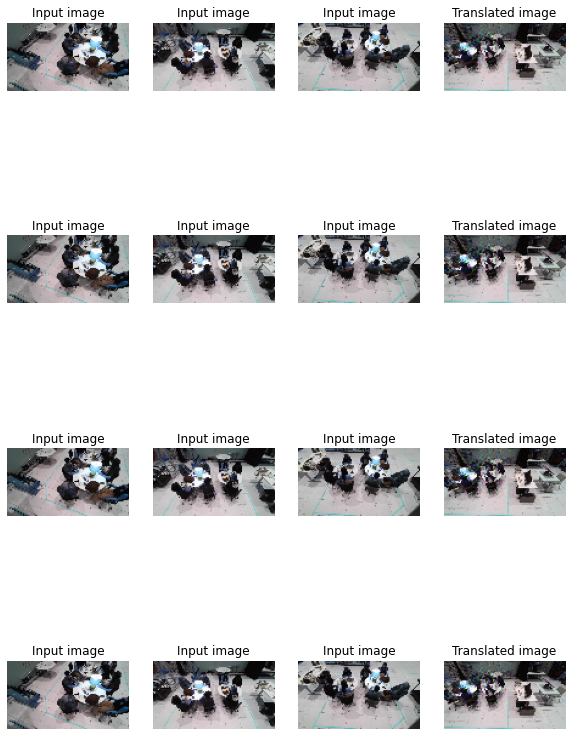

7/7 [==============================] - 12s 2s/step - X_loss: 1.4412 - Y_loss: 1.7630 - Z_loss: 1.2039 - W_loss: 1.5183 - D_X_loss: 0.1005 - D_Y_loss: 0.0526 - D_Z_loss: 0.1142 - D_W_loss: 0.0993
Epoch 50/50
7/7 [==============================] - ETA: 0s - X_loss: 1.4729 - Y_loss: 1.7745 - Z_loss: 1.2380 - W_loss: 1.5811 - D_X_loss: 0.0336 - D_Y_loss: 0.0211 - D_Z_loss: 0.1324 - D_W_loss: 0.0649

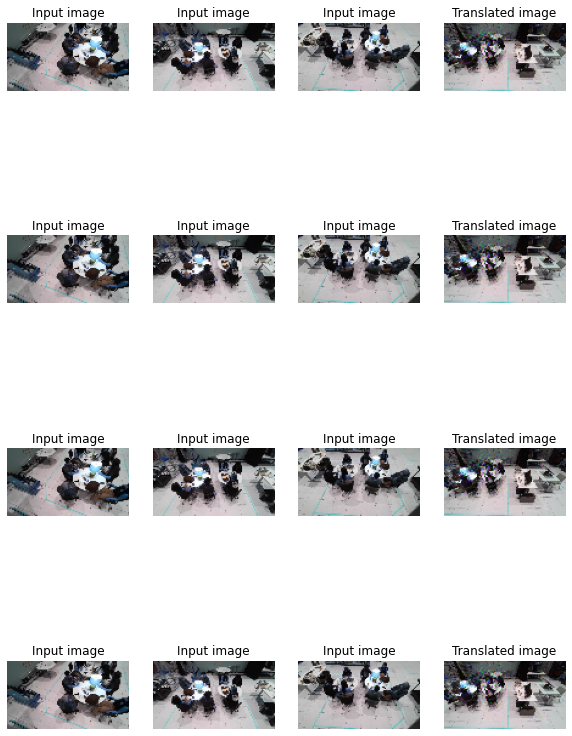

7/7 [==============================] - 12s 2s/step - X_loss: 1.4644 - Y_loss: 1.7706 - Z_loss: 1.2375 - W_loss: 1.5573 - D_X_loss: 0.0319 - D_Y_loss: 0.0265 - D_Z_loss: 0.1278 - D_W_loss: 0.0653


In [ ]:

# Loss function for evaluating adversarial loss
adv_loss_fn = keras.losses.MeanSquaredError()

# Define the loss function for the generators
def generator_loss_fn(fake):
    fake_loss = adv_loss_fn(tf.ones_like(fake), fake)
    return fake_loss


# Define the loss function for the discriminators
def discriminator_loss_fn(real, fake):
    real_loss = adv_loss_fn(tf.ones_like(real), real)
    fake_loss = adv_loss_fn(tf.zeros_like(fake), fake)
    return (real_loss + fake_loss) * 0.5


# Create cycle gan model
'''
cycle_gan_model = CycleGan(
    generator_G=gen_G, generator_F=gen_F, discriminator_X=disc_X, discriminator_Y=disc_Y
)
'''
cycle_gan_model = CycleGan(
    generator_X=gen_X, 
    generator_Y=gen_Y, 
    generator_Z=gen_Z, 
    generator_W=gen_W, 
    discriminator_X=disc_X, 
    discriminator_Y=disc_Y,
    discriminator_Z=disc_Z, 
    discriminator_W=disc_W
)
# Compile the model
'''
cycle_gan_model.compile(
    gen_G_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    gen_F_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    disc_X_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    disc_Y_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    gen_loss_fn=generator_loss_fn,
    disc_loss_fn=discriminator_loss_fn,
)
'''
cycle_gan_model.compile(
    gen_X_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    gen_Y_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    gen_Z_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    gen_W_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    disc_X_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    disc_Y_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    disc_Z_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    disc_W_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    gen_loss_fn=generator_loss_fn,
    disc_loss_fn=discriminator_loss_fn,
)
# Callbacks
plotter = GANMonitor()
#checkpoint_filepath = "./model_checkpoints/cyclegan_checkpoints.{epoch:03d}"
checkpoint_filepath = "/content/drive/MyDrive/Research/model_checkpoints/cyclegan_checkpoints.{epoch:03d}"
model_checkpoint_callback = keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath
)

# Here we will train the model for just one epoch as each epoch takes around
# 7 minutes on a single P100 backed machine.
cycle_gan_model.fit(
    tf.data.Dataset.zip((train_angles_3, train_angles_1)),
    epochs=50,
    #callbacks=[plotter, model_checkpoint_callback],
    callbacks=[plotter]
)

Test the performance of the model.

In [ ]:

# This model was trained for 90 epochs. We will be loading those weights
# here. Once the weights are loaded, we will take a few samples from the test
# data and check the model's performance.

In [ ]:

# Load the checkpoints
#weight_file = "./saved_checkpoints/cyclegan_checkpoints.090"
#cycle_gan_model.load_weights(weight_file).expect_partial()
#print("Weights loaded successfully")

#_, ax = plt.subplots(4, 2, figsize=(10, 15))
for i, img in enumerate(zip(test_angles_3, test_angles_1)):
    prediction = cycle_gan_model.gen_Z(img[0], training=False)[0][0].numpy()
    #print(img[0].shape)
    #print(img[1].shape)
    prediction = (prediction * 127.5 + 127.5).astype(np.uint8) # predicted image
    img = (img[1][0][0] * 127.5 + 127.5).numpy().astype(np.uint8) # real image
    '''
    ax[i, 0].imshow(img)
    ax[i, 1].imshow(prediction)
    ax[i, 0].set_title("Input image")
    ax[i, 0].set_title("Input image")
    ax[i, 1].set_title("Translated image")
    ax[i, 0].axis("off")
    ax[i, 1].axis("off")
    '''
    prediction = keras.preprocessing.image.array_to_img(prediction)
    real = keras.preprocessing.image.array_to_img(img)
    prediction.save("/content/drive/MyDrive/Research/CycleGAN_Gifs/CycleGAN_3to1_imgs/mult_predicted_img_{i}.jpg".format(i=i))
    real.save("/content/drive/MyDrive/Research/CycleGAN_Gifs/CycleGAN_3to1_imgs/mult_real_img_{i}.jpg".format(i=i))
#plt.tight_layout()
#plt.show()


In [ ]:
import glob
from PIL import Image

In [ ]:
# filepaths
#fp_in = "/path/to/image_*.png"
#fp_in = "/content/drive/MyDrive/Research/CycleGAN_imgs/generated_img_0_*.png"
fp_in = "/content/drive/MyDrive/Research/CycleGAN_Gifs/CycleGAN_3to1_imgs/mult_predicted_img_*.png"
#fp_in = "/content/predicted_img_*.png"
#fp_out = "/path/to/image.gif"
fp_out = "/content/drive/MyDrive/Research/CycleGAN_Gifs/CycleGAN_predicted_mult_3to1.gif"

# https://pillow.readthedocs.io/en/stable/handbook/image-file-formats.html#gif
img, *imgs = [Image.open(f) for f in sorted(glob.glob(fp_in))]
img.save(fp=fp_out, format='GIF', append_images=imgs,
         save_all=True, duration=500, loop=0)

In [ ]:
# filepaths
#fp_in = "/path/to/image_*.png"
#fp_in = "/content/drive/MyDrive/Research/CycleGAN_imgs/generated_img_0_*.png"
fp_in = "/content/drive/MyDrive/Research/CycleGAN_Gifs/CycleGAN_3to1_imgs/mult_real_img_*.png"
#fp_in = "/content/predicted_img_*.png"
#fp_out = "/path/to/image.gif"
fp_out = "/content/drive/MyDrive/Research/CycleGAN_Gifs/CycleGAN_real_mult_3to1.gif"

# https://pillow.readthedocs.io/en/stable/handbook/image-file-formats.html#gif
img, *imgs = [Image.open(f) for f in sorted(glob.glob(fp_in))]
img.save(fp=fp_out, format='GIF', append_images=imgs,
         save_all=True, duration=500, loop=0)

In [ ]:
from IPython.display import display, Image
A = Image(open('/content/drive/MyDrive/Research/CycleGAN_Gifs/CycleGAN_predicted_mult_3to1.gif','rb').read())
B = Image(open('/content/drive/MyDrive/Research/CycleGAN_Gifs/CycleGAN_real_mult_3to1.gif','rb').read())

In [ ]:
display(A)
display(B)

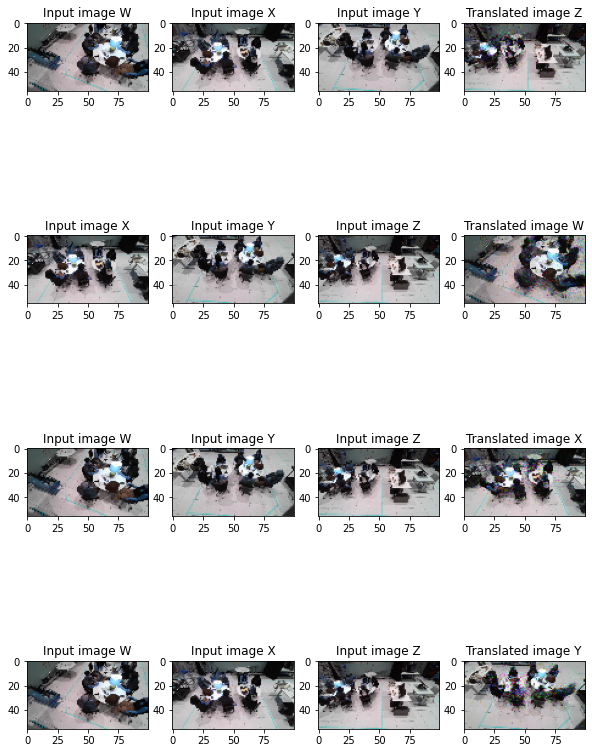

In [ ]:
_, ax = plt.subplots(4, 4, figsize=(10, 15))
for i, img in enumerate(zip(test_angles_3.take(1), test_angles_1.take(1))):
    W,X,Y,Z = img[0][0][0],img[0][0][1],img[0][0][2],img[1][0][0]
    input1 = [W,X,Y] # W,X,Y -> Z
    input1 = tf.expand_dims(tf.stack(input1,axis=0), axis=0)
    input2 = [X,Y,Z] # X,Y,Z -> W
    input2 = tf.expand_dims(tf.stack(input2,axis=0), axis=0)
    input3 = [W,Y,Z] # W,Y,Z -> X
    input3 = tf.expand_dims(tf.stack(input3,axis=0), axis=0)
    input4 = [W,X,Z] # W,X,Z -> Y
    input4 = tf.expand_dims(tf.stack(input4,axis=0), axis=0)
    #print(input1.shape)
    #print(img[0].shape)
    prediction1 = cycle_gan_model.gen_Z(input1, training=False)[0][0].numpy()
    prediction2 = cycle_gan_model.gen_W(input2, training=False)[0][0].numpy()
    prediction3 = cycle_gan_model.gen_X(input3, training=False)[0][0].numpy()
    prediction4 = cycle_gan_model.gen_Y(input4, training=False)[0][0].numpy()
    #print(img[0].shape)
    #print(img[1].shape)
    prediction1 = (prediction1 * 127.5 + 127.5).astype(np.uint8) # predicted image
    prediction2 = (prediction2 * 127.5 + 127.5).astype(np.uint8) # predicted image
    prediction3 = (prediction3 * 127.5 + 127.5).astype(np.uint8) # predicted image
    prediction4 = (prediction4 * 127.5 + 127.5).astype(np.uint8) # predicted image
    X = (X * 127.5 + 127.5).numpy().astype(np.uint8) # real image input
    Y = (Y * 127.5 + 127.5).numpy().astype(np.uint8) # real image input
    Z = (Z * 127.5 + 127.5).numpy().astype(np.uint8) # real image input
    W = (W * 127.5 + 127.5).numpy().astype(np.uint8) # real image input
    
    ax[0, 0].imshow(W)
    ax[0, 1].imshow(X)
    ax[0, 2].imshow(Y)
    ax[0, 3].imshow(prediction1)
    ax[0, 0].set_title("Input image W")
    ax[0, 1].set_title("Input image X")
    ax[0, 2].set_title("Input image Y")
    ax[0, 3].set_title("Translated image Z")

    ax[1, 0].imshow(X)
    ax[1, 1].imshow(Y)
    ax[1, 2].imshow(Z)
    ax[1, 3].imshow(prediction2)
    ax[1, 0].set_title("Input image X")
    ax[1, 1].set_title("Input image Y")
    ax[1, 2].set_title("Input image Z")
    ax[1, 3].set_title("Translated image W")

    ax[2, 0].imshow(W)
    ax[2, 1].imshow(Y)
    ax[2, 2].imshow(Z)
    ax[2, 3].imshow(prediction3)
    ax[2, 0].set_title("Input image W")
    ax[2, 1].set_title("Input image Y")
    ax[2, 2].set_title("Input image Z")
    ax[2, 3].set_title("Translated image X")
    #ax[i, 0].axis("off")
    #ax[i, 1].axis("off")

    ax[3, 0].imshow(W)
    ax[3, 1].imshow(X)
    ax[3, 2].imshow(Z)
    ax[3, 3].imshow(prediction4)
    ax[3, 0].set_title("Input image W")
    ax[3, 1].set_title("Input image X")
    ax[3, 2].set_title("Input image Z")
    ax[3, 3].set_title("Translated image Y")
    
plt.show()
plt.close()